In [1]:
import numpy as np
import os
import glob 
import time 
import pandas as pd
import shutil
import re
import mdtraj as md
import MDAnalysis as mda
import pickle
import pickle as p 
import csv
import sys
import subprocess
import xml.etree.ElementTree as ET
import requests
import concurrent.futures
import multiprocessing
import nglview as nv
import h5py
import matplotlib as mpl
import matplotlib.patheffects as path_effects
import matplotlib.patches as patches
import html
import biobox as bb
import tempfile
import matplotlib.pyplot as plt
import molearn
import torch
import glob as glob
import MDAnalysis.analysis.rms as rms
import seaborn as sns
import pickle
import networkx as nx
sys.path.insert(0, os.path.join(os.path.abspath(os.pardir),'src'))

from Bio import PDB
from tqdm import tqdm
from time import time as t
from urllib.request import urlretrieve as download
from Bio.Blast import NCBIWWW, NCBIXML
from Bio.Blast.Applications import NcbipsiblastCommandline
from collections import defaultdict
from Bio.PDB import PPBuilder
from Bio.SeqUtils import seq1
from modeller import *
from modeller.automodel import *
from Bio.PDB import PDBParser
from MDAnalysis.analysis import align
from mpi4py import MPI
from glob import glob
from pprint import pprint as pp
from matplotlib import pyplot as plt
from sklearn.decomposition import PCA
from glob import glob as g
from tqdm.notebook import tqdm
from collections import Counter
from matplotlib.ticker import FuncFormatter
from collections import defaultdict
from pymol import cmd
from scipy.interpolate import interp1d
from mpl_toolkits import mplot3d
from scipy import stats
from sklearn.cluster import AgglomerativeClustering, SpectralClustering
from matplotlib.colors import BoundaryNorm
from numpy.linalg import norm
from molearn.data import PDBData
from molearn.trainers import Trainer
from molearn.models.small_foldingnet import Small_AutoEncoder
from molearn.analysis.analyser import MolearnAnalysis
from copy import deepcopy
from molearn.analysis import MolearnGUI
from scipy.ndimage import rotate
from numpy.linalg import inv
from sklearn.cluster import HDBSCAN
from sklearn.metrics import silhouette_score
from itertools import combinations
from urllib.request import urlretrieve
from urllib.error import URLError
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, precision_score, recall_score, ConfusionMatrixDisplay
from sklearn.inspection import permutation_importance
from sklearn.tree import export_graphviz
from sklearn import tree
from scipy.stats import pearsonr


Running MUSTANG Algorithm

Creating a folder for unreconstructed structures to be used in MUSTANG alignment.

In [2]:
def create_nonreconstructed_folder():
    unaligned_dir = "Results/activation_segments/unaligned"
    reconstructed_dir = "Results/activation_segments/reconstructedModeller"
    target_dir = "Results/activation_segments/nonReconstructed4Mustang"
    
    if not os.path.exists(target_dir):
        os.makedirs(target_dir)
        print(f"Created directory: {target_dir}")
    
    unaligned_files = [f for f in os.listdir(unaligned_dir) if f.endswith('.pdb')]
    reconstructed_files = [f for f in os.listdir(reconstructed_dir) if f.endswith('.pdb')]
    
    # Extract the first 6 characters of each reconstructed filename to identify corresponding entries
    reconstructed_prefixes = {f[:6] for f in reconstructed_files}
    
    copied_count = 0
    skipped_count = 0
    
    for unaligned_file in unaligned_files:
        file_prefix = unaligned_file[:6]
        
        if file_prefix in reconstructed_prefixes:
            source_path = os.path.join(unaligned_dir, unaligned_file)
            target_path = os.path.join(target_dir, unaligned_file)
            
            # Copy unaligned file to the target directory if it was reconstructed
            shutil.copy(source_path, target_path)
            copied_count += 1
        else:
            skipped_count += 1
    
    print(f"Copied {copied_count} files from '{unaligned_dir}' to '{target_dir}'")
    print(f"Skipped {skipped_count} files that don't have matching entries in '{reconstructed_dir}'")
    print(f"These files have matching entries in '{reconstructed_dir}' based on the first 6 characters")

if __name__ == '__main__':
    create_nonreconstructed_folder()
    print("Processing complete!")

Created directory: Results/activation_segments/nonReconstructed4Mustang
Copied 3845 files from 'Results/activation_segments/unaligned' to 'Results/activation_segments/nonReconstructed4Mustang'
Skipped 8467 files that don't have matching entries in 'Results/activation_segments/reconstructedModeller'
These files have matching entries in 'Results/activation_segments/reconstructedModeller' based on the first 6 characters
Processing complete!


Select the structures who have DFG and APE

In [3]:
"""
Filter PDB files from a directory that contain the specific structural motifs DFG and APE, ensuring that they appear in a valid order (with DFG preceding APE and a reasonable distance between them). Qualified structures are copied to a new directory for further use, and all processing details are recorded in a log file for review and traceability.
"""
import os
import shutil
from glob import glob
from Bio.PDB import PDBParser, PPBuilder

pdb_dir = "Results/activation_segments/nonReconstructed4Mustang/"
filtered_dir = "Results/activation_segments/nonReconstructed4Mustang_filtered/"
log_dir = "Results/activation_segments/nonReconstructed4Mustang_filtered/"
log_file = os.path.join(log_dir, "motif_verification_log.txt")

os.makedirs(filtered_dir, exist_ok=True)
os.makedirs(log_dir, exist_ok=True)

print(f"Created/verified directories:\n- {filtered_dir}\n- {log_dir}")

with open(log_file, 'w') as f:
    f.write("Motif Verification Log\n")
    f.write("=====================\n\n")

def log_message(message):
    """Write message to log file and print to console."""
    print(message)
    try:
        with open(log_file, 'a') as f:
            f.write(message + "\n")
    except Exception as e:
        print(f"WARNING: Could not write to log file: {e}")

def extract_atom_sequence(pdb_file):
    parser = PDBParser(QUIET=True)
    try:
        structure = parser.get_structure('PDB', pdb_file)
        
        for model in structure:
            for chain in model:
                ppb = PPBuilder()
                sequence = ''
                for pp in ppb.build_peptides(chain):
                    sequence += pp.get_sequence()
                return str(sequence)
    except Exception as e:
        log_message(f"Error extracting sequence from {pdb_file}: {e}")
    return None

def find_motif_indices(seq, motif):
    index = seq.find(motif)
    if index == -1:
        return None
    return index, index + len(motif)

def find_dfg_motif_index(seq):
    for motif in ["DFG"]:
        result = find_motif_indices(seq, motif)
        if result is not None:
            return result, motif
    return None, None

def find_ape_motif_index(seq):
    for motif in ["APE"]:
        result = find_motif_indices(seq, motif)
        if result is not None:
            return result, motif
    return None, None

def filter_structures_by_motifs():
    # Check if input directory exists
    if not os.path.exists(pdb_dir):
        log_message(f"ERROR: Input directory does not exist: {pdb_dir}")
        return False
        
    fps = glob(pdb_dir + "/*.pdb")
    log_message(f"Found {len(fps)} PDB files to check.")
    
    valid_count = 0
    invalid_count = 0
    
    for fp in fps:
        pdb_code = os.path.basename(fp).split('.')[0]
        log_message(f"\nChecking {pdb_code}...")
        
        seq = extract_atom_sequence(fp)
        if seq is None:
            log_message(f"  - Could not extract sequence. Skipping.")
            invalid_count += 1
            continue
        
        dfg_result, dfg_motif = find_dfg_motif_index(seq)
        
        ape_result, ape_motif = find_ape_motif_index(seq)

        # Only keep files where both DFG and APE motifs are found
        if dfg_result is not None and ape_result is not None:
            dfg_start, dfg_end = dfg_result
            ape_start, ape_end = ape_result
            
            # Motifs must appear in correct order and be at least 5 residues apart
            if dfg_start < ape_start and (ape_start - dfg_end) >= 5:
                log_message(f"  - Found {dfg_motif} at position {dfg_start} and {ape_motif} at position {ape_start}")
                
                # Copy the valid PDB file to the filtered directory
                dest_path = os.path.join(filtered_dir, os.path.basename(fp))
                shutil.copy(fp, dest_path)
                log_message(f"  - Copying to {dest_path}")
                valid_count += 1
            else:
                log_message(f"  - Found motifs but in wrong order or too close: {dfg_motif}({dfg_start}) and {ape_motif}({ape_start})")
                invalid_count += 1
        else:
            # Log which motif was missing
            if dfg_result is None:
                log_message(f"  - DFG motif not found")
            if ape_result is None:
                log_message(f"  - APE motif not found")
            invalid_count += 1
    
    # Summary of results
    log_message(f"\nFiltering complete:")
    log_message(f"  - {valid_count} structures have valid DFG and APE motifs")
    log_message(f"  - {invalid_count} structures were excluded")
    log_message(f"  - Valid structures copied to {filtered_dir}")
    
    return valid_count > 0

if __name__ == '__main__':
    log_message(f"Starting filtering process. Working directory: {os.getcwd()}")
    log_message(f"Using input directory: {pdb_dir}")
    log_message(f"Output directory: {filtered_dir}")
    
    log_message("Filtering structures based on presence of DFG and APE motifs...")
    motifs_present = filter_structures_by_motifs()
    
    if motifs_present:
        log_message("\nFiltering process complete! Filtered structures saved to:")
        log_message(filtered_dir)
    else:
        log_message("No valid structures found with both DFG and APE motifs.")

Created/verified directories:
- Results/activation_segments/nonReconstructed4Mustang_filtered/
- Results/activation_segments/nonReconstructed4Mustang_filtered/
Starting filtering process. Working directory: d:\BRAF_work\BRAF-COOP\BRAF
Using input directory: Results/activation_segments/nonReconstructed4Mustang/
Output directory: Results/activation_segments/nonReconstructed4Mustang_filtered/
Filtering structures based on presence of DFG and APE motifs...
Found 3845 PDB files to check.

Checking 1A9U_A...
  - Found DFG at position 164 and APE at position 186
  - Copying to Results/activation_segments/nonReconstructed4Mustang_filtered/1A9U_A.pdb

Checking 1AD5_A...
  - Found DFG at position 320 and APE at position 336
  - Copying to Results/activation_segments/nonReconstructed4Mustang_filtered/1AD5_A.pdb

Checking 1AD5_B...
  - Found DFG at position 320 and APE at position 336
  - Copying to Results/activation_segments/nonReconstructed4Mustang_filtered/1AD5_B.pdb

Checking 1AGW_A...
  - Fo

Run MUSTANG and attain RMSD value

In [4]:
"""
This script performs structural alignment using the MUSTANG tool between a given template PDB file and multiple target PDB structures. It parses the RMSD values from the alignment results, organizes all output files into dedicated folders per structure, and writes a summary of RMSD values for all successfully aligned structures. 
"""

import os
import subprocess
from glob import glob
from time import time
import re  

# Define paths for input PDBs, output results, and template structure
pdb_path = "Results/activation_segments/nonReconstructed4Mustang_filtered"
target_dir = "Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD"
template_pdb = "6UAN_chainD.pdb"
os.makedirs(target_dir, exist_ok=True)

print(f"Input directory: {pdb_path}")
print(f"Output directory: {target_dir}")
print(f"Template PDB: {template_pdb}")

# Utility to get all .pdb files from a given directory
def find_pdbs(directory):
    return glob(os.path.join(directory, "*.pdb"))

# Utility to extract file name without extension
def fname(path):
    return os.path.splitext(os.path.basename(path))[0]

# Run MUSTANG alignment between the template and input structure, and extract RMSD
def run_mustang(template_pdb, input_pdb, name=None):
    if name is None:
        name = fname(input_pdb)
    
    try:
        struct_dir = os.path.join(target_dir, name)
        os.makedirs(struct_dir, exist_ok=True)
        new_fp = os.path.join(struct_dir, name)
        structs = f"{template_pdb} {input_pdb}"
        command = f"mustang -i {structs} -o {new_fp} -F fasta -s ON -r ON"
        print(f"Running MUSTANG: {command}")
        
        result = subprocess.run(command, shell=True, capture_output=True, text=True)
        
        if result.returncode != 0:
            print(f"MUSTANG failed: {result.stderr}")
            return None, None
        
        rmsd_file = os.path.join(struct_dir, f"{name}.rms_rot")
        rmsd_value = None

        if os.path.exists(rmsd_file):
            with open(rmsd_file, "r") as f:
                lines = f.readlines()
                for line in lines:
                    if line.strip().startswith("2|"):  
                        parts = line.strip().split("|")[-1].split()
                        for part in parts:
                            try:
                                rmsd_value = float(part)
                                break
                            except ValueError:
                                continue
                        break
        else:
            print(f"Warning: RMSD file not found for {name}")

        expected_output = os.path.join(struct_dir, f"{name}.pdb")
        if not os.path.exists(expected_output):
            alt_files = glob(os.path.join(struct_dir, "*.pdb"))
            if alt_files:
                expected_output = alt_files[0]
            else:
                return None, rmsd_value

        print(f"Successfully aligned {name}, RMSD = {rmsd_value}")
        return expected_output, rmsd_value  

    except Exception as e:
        print(f"Error running MUSTANG for {name}: {e}")
        return None, None

if __name__ == '__main__':
    pdbs = find_pdbs(pdb_path)
    print(f"Found {len(pdbs)} PDB files to process")

    t1 = time()
    results = []  

    for pdb in pdbs:
        name = fname(pdb)
        _, rmsd = run_mustang(template_pdb, pdb, name=name)
        if rmsd is not None:
            results.append((name, rmsd))

    t2 = time()
    print(f"Processing complete in {round(t2 - t1, 3)} seconds")

    output_path = os.path.join(target_dir, "mustang_rmsd_summary.txt")
    with open(output_path, "w") as f:
        f.write("PDB_Name\tRMSD\n")
        for name, rmsd in results:
            f.write(f"{name}\t{rmsd:.4f}\n")

    print(f"RMSD summary saved to {output_path}")


Exception in thread Thread-4 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-6 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_ru

Input directory: Results/activation_segments/nonReconstructed4Mustang_filtered
Output directory: Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD
Template PDB: 6UAN_chainD.pdb
Found 3808 PDB files to process
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1A9U_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1A9U_A\1A9U_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1AD5_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1AD5_A\1AD5_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1AD5_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1AD5_B\1AD5_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6

Exception in thread Thread-10 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-12 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1APM_E.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1APM_E\1APM_E -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1ATP_E.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1ATP_E\1ATP_E -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1B38_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1B38_A\1B38_A -F fasta -s ON -r ON


Exception in thread Thread-16 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-18 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1B39_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1B39_A\1B39_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1BI7_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1BI7_A\1BI7_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1BI8_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1BI8_A\1BI8_A -F fasta -s ON -r ON


Exception in thread Thread-24 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-26 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1BI8_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1BI8_C\1BI8_C -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1BKX_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1BKX_A\1BKX_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1BL6_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1BL6_A\1BL6_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1BL7_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1BL7_A\1BL7_A -F fasta -s ON -r ON


Exception in thread Thread-30 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-32 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1BLX_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1BLX_A\1BLX_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1BMK_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1BMK_A\1BMK_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1BUH_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1BUH_A\1BUH_A -F fasta -s ON -r ON


Exception in thread Thread-36 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-38 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1BX6_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1BX6_A\1BX6_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1CDK_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1CDK_A\1CDK_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1CDK_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1CDK_B\1CDK_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1CM8_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1CM8_A\1CM8_A -F fasta -s ON -r ON


Exception in thread Thread-44 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-46 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1CM8_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1CM8_B\1CM8_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1CMK_E.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1CMK_E\1CMK_E -F fasta -s ON -r ON


Exception in thread Thread-48 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-50 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1CTP_E.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1CTP_E\1CTP_E -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1DI9_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1DI9_A\1DI9_A -F fasta -s ON -r ON


Exception in thread Thread-52 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-54 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1E1V_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1E1V_A\1E1V_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1E1X_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1E1X_A\1E1X_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1E9H_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1E9H_A\1E9H_A -F fasta -s ON -r ON


Exception in thread Thread-58 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-60 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1E9H_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1E9H_C\1E9H_C -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1F5Q_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1F5Q_A\1F5Q_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1F5Q_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1F5Q_C\1F5Q_C -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1FGI_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1FGI_A\1FGI_A -F fasta -s ON -r ON


    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-68 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\sub

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1FGK_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1FGK_A\1FGK_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1FIN_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1FIN_A\1FIN_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1FIN_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1FIN_C\1FIN_C -F fasta -s ON -r ON


Exception in thread Thread-74 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-76 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1FMO_E.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1FMO_E\1FMO_E -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1FOT_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1FOT_A\1FOT_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1FPU_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1FPU_A\1FPU_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1FPU_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1FPU_B\1FPU_B -F fasta -s ON -r ON


Exception in thread Thread-80 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-82 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1FQ1_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1FQ1_B\1FQ1_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1FVV_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1FVV_A\1FVV_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1FVV_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1FVV_C\1FVV_C -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1G3N_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1G3N_A\1G3N_A -F fasta -s ON -r ON


Exception in thread Thread-88 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-90 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1G3N_E.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1G3N_E\1G3N_E -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1GAG_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1GAG_A\1GAG_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1GJO_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1GJO_A\1GJO_A -F fasta -s ON -r ON


    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-96 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\sub

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1GNG_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1GNG_A\1GNG_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1GNG_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1GNG_B\1GNG_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1GOL_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1GOL_A\1GOL_A -F fasta -s ON -r ON


    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-102 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\su

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1GY3_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1GY3_A\1GY3_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1GY3_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1GY3_C\1GY3_C -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1GZ8_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1GZ8_A\1GZ8_A -F fasta -s ON -r ON


    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-108 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\su

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1H01_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1H01_A\1H01_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1H07_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1H07_A\1H07_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1H0V_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1H0V_A\1H0V_A -F fasta -s ON -r ON


    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-114 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\su

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1H1P_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1H1P_A\1H1P_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1H1P_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1H1P_C\1H1P_C -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1H1Q_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1H1Q_A\1H1Q_A -F fasta -s ON -r ON


Exception in thread Thread-118 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-120 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1H1Q_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1H1Q_C\1H1Q_C -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1H1R_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1H1R_A\1H1R_A -F fasta -s ON -r ON


    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-124 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\su

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1H1R_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1H1R_C\1H1R_C -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1H1S_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1H1S_A\1H1S_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1H1S_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1H1S_C\1H1S_C -F fasta -s ON -r ON


Exception in thread Thread-128 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-130 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1H24_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1H24_A\1H24_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1H24_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1H24_C\1H24_C -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1H25_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1H25_A\1H25_A -F fasta -s ON -r ON


    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-136 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\su

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1H25_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1H25_C\1H25_C -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1H26_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1H26_A\1H26_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1H26_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1H26_C\1H26_C -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1H27_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1H27_A\1H27_A -F fasta -s ON -r ON


Exception in thread Thread-142 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-144 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1H27_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1H27_C\1H27_C -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1H28_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1H28_A\1H28_A -F fasta -s ON -r ON


Exception in thread Thread-148 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-150 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1H28_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1H28_C\1H28_C -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1H8F_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1H8F_A\1H8F_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1H8F_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1H8F_B\1H8F_B -F fasta -s ON -r ON


Exception in thread Thread-154 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-156 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1HCK_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1HCK_A\1HCK_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1HCL_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1HCL_A\1HCL_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1I09_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1I09_A\1I09_A -F fasta -s ON -r ON


Exception in thread Thread-160 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-162 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1I09_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1I09_B\1I09_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1IA8_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1IA8_A\1IA8_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1IEP_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1IEP_A\1IEP_A -F fasta -s ON -r ON


    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-166 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\su

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1IEP_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1IEP_B\1IEP_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1IG1_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1IG1_A\1IG1_A -F fasta -s ON -r ON


Exception in thread Thread-168 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-170 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1IR3_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1IR3_A\1IR3_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1IRK_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1IRK_A\1IRK_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1J1B_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1J1B_A\1J1B_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1J1B_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1J1B_B\1J1B_B -F fasta -s ON -r ON


Exception in thread Thread-176 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-178 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1J1C_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1J1C_A\1J1C_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1J1C_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1J1C_B\1J1C_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1J3H_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1J3H_A\1J3H_A -F fasta -s ON -r ON


Exception in thread Thread-182 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-184 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1J3H_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1J3H_B\1J3H_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1JBP_E.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1JBP_E\1JBP_E -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1JKK_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1JKK_A\1JKK_A -F fasta -s ON -r ON


Exception in thread Thread-188 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-190 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1JKL_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1JKL_A\1JKL_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1JKS_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1JKS_A\1JKS_A -F fasta -s ON -r ON


Exception in thread Thread-192 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-194 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1JKT_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1JKT_A\1JKT_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1JKT_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1JKT_B\1JKT_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1JLU_E.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1JLU_E\1JLU_E -F fasta -s ON -r ON


Exception in thread Thread-200 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-202 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1JOW_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1JOW_B\1JOW_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1JST_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1JST_A\1JST_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1JST_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1JST_C\1JST_C -F fasta -s ON -r ON


Exception in thread Thread-206 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-208 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1JSU_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1JSU_A\1JSU_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1JSV_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1JSV_A\1JSV_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1KOA_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1KOA_A\1KOA_A -F fasta -s ON -r ON


Exception in thread Thread-210 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-212 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1KOB_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1KOB_A\1KOB_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1KOB_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1KOB_B\1KOB_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1KSW_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1KSW_A\1KSW_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1L3R_E.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1L3R_E\1L3R_E -F fasta -s ON -r ON


Exception in thread Thread-218 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-220 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1M52_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1M52_A\1M52_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1M52_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1M52_B\1M52_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1M7Q_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1M7Q_A\1M7Q_A -F fasta -s ON -r ON


Exception in thread Thread-224 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-226 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1NVQ_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1NVQ_A\1NVQ_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1NVR_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1NVR_A\1NVR_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1NVS_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1NVS_A\1NVS_A -F fasta -s ON -r ON


Exception in thread Thread-230 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-232 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1O6K_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1O6K_A\1O6K_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1O6L_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1O6L_A\1O6L_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1O9U_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1O9U_A\1O9U_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1OEC_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1OEC_A\1OEC_A -F fasta -s ON -r ON


Exception in thread Thread-238 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-240 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1OGU_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1OGU_A\1OGU_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1OGU_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1OGU_C\1OGU_C -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1OI9_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1OI9_A\1OI9_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1OI9_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1OI9_C\1OI9_C -F fasta -s ON -r ON


Exception in thread Thread-246 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-248 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1OIR_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1OIR_A\1OIR_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1OIU_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1OIU_A\1OIU_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1OIU_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1OIU_C\1OIU_C -F fasta -s ON -r ON


    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-254 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\su

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1OIY_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1OIY_A\1OIY_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1OIY_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1OIY_C\1OIY_C -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1OKV_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1OKV_A\1OKV_A -F fasta -s ON -r ON


Exception in thread Thread-258 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-260 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1OKV_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1OKV_C\1OKV_C -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1OKW_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1OKW_A\1OKW_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1OKW_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1OKW_C\1OKW_C -F fasta -s ON -r ON


Exception in thread Thread-264 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-266 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1OL1_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1OL1_A\1OL1_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1OL1_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1OL1_C\1OL1_C -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1OL2_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1OL2_A\1OL2_A -F fasta -s ON -r ON


Exception in thread Thread-270 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-272 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1OL2_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1OL2_C\1OL2_C -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1OPJ_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1OPJ_A\1OPJ_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1OPJ_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1OPJ_B\1OPJ_B -F fasta -s ON -r ON


Exception in thread Thread-276 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-278 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1OPK_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1OPK_A\1OPK_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1OPL_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1OPL_A\1OPL_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1OPL_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1OPL_B\1OPL_B -F fasta -s ON -r ON


    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-284 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\su

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1OUK_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1OUK_A\1OUK_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1OUY_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1OUY_A\1OUY_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1OVE_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1OVE_A\1OVE_A -F fasta -s ON -r ON


    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-290 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1OZ1_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1OZ1_A\1OZ1_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1P4F_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1P4F_A\1P4F_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1P5E_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1P5E_A\1P5E_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1P5E_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1P5E_C\1P5E_C -F fasta -s ON -r ON


Exception in thread Thread-296 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-298 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1PF8_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1PF8_A\1PF8_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1PHK_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1PHK_A\1PHK_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1PKD_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1PKD_A\1PKD_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1PKD_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1PKD_C\1PKD_C -F fasta -s ON -r ON


Exception in thread Thread-304 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-306 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1PKG_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1PKG_A\1PKG_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1PME_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1PME_A\1PME_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1PW2_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1PW2_A\1PW2_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1PXI_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1PXI_A\1PXI_A -F fasta -s ON -r ON


Exception in thread Thread-312 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-314 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1PXJ_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1PXJ_A\1PXJ_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1PXK_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1PXK_A\1PXK_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1PXL_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1PXL_A\1PXL_A -F fasta -s ON -r ON


Exception in thread Thread-318 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-320 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1PXM_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1PXM_A\1PXM_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1PXN_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1PXN_A\1PXN_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1PXO_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1PXO_A\1PXO_A -F fasta -s ON -r ON


Exception in thread Thread-324 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-326 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1PXP_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1PXP_A\1PXP_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1PYX_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1PYX_A\1PYX_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1PYX_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1PYX_B\1PYX_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1Q24_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1Q24_A\1Q24_A -F fasta -s ON -r ON


    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-334 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\su

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1Q3D_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1Q3D_A\1Q3D_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1Q3D_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1Q3D_B\1Q3D_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1Q3W_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1Q3W_A\1Q3W_A -F fasta -s ON -r ON


Exception in thread Thread-338 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-340 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1Q3W_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1Q3W_B\1Q3W_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1Q41_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1Q41_A\1Q41_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1Q41_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1Q41_B\1Q41_B -F fasta -s ON -r ON


Exception in thread Thread-344 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-346 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1Q4L_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1Q4L_A\1Q4L_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1Q4L_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1Q4L_B\1Q4L_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1Q5K_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1Q5K_A\1Q5K_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1Q5K_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1Q5K_B\1Q5K_B -F fasta -s ON -r ON


Exception in thread Thread-352 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-354 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1Q61_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1Q61_A\1Q61_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1Q62_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1Q62_A\1Q62_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1Q8T_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1Q8T_A\1Q8T_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1Q8U_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1Q8U_A\1Q8U_A -F fasta -s ON -r ON


Exception in thread Thread-360 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-362 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1Q8W_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1Q8W_A\1Q8W_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1QCF_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1QCF_A\1QCF_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1QL6_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1QL6_A\1QL6_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1QMZ_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1QMZ_A\1QMZ_A -F fasta -s ON -r ON


    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-370 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\su

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1QMZ_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1QMZ_C\1QMZ_C -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1QPC_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1QPC_A\1QPC_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1QPD_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1QPD_A\1QPD_A -F fasta -s ON -r ON


Exception in thread Thread-376 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-378 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1QPE_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1QPE_A\1QPE_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1QPJ_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1QPJ_A\1QPJ_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1R0E_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1R0E_A\1R0E_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1R0E_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1R0E_B\1R0E_B -F fasta -s ON -r ON


Exception in thread Thread-382 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-384 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1R39_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1R39_A\1R39_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1R3C_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1R3C_A\1R3C_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1RDQ_E.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1RDQ_E\1RDQ_E -F fasta -s ON -r ON


    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-390 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\su

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1RE8_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1RE8_A\1RE8_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1REJ_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1REJ_A\1REJ_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1REK_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1REK_A\1REK_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1RJB_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1RJB_A\1RJB_A -F fasta -s ON -r ON


Exception in thread Thread-396 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-398 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1RQQ_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1RQQ_A\1RQQ_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1RQQ_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1RQQ_B\1RQQ_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1S9I_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1S9I_A\1S9I_A -F fasta -s ON -r ON


    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-404 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\su

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1SMH_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1SMH_A\1SMH_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1STC_E.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1STC_E\1STC_E -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1SVE_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1SVE_A\1SVE_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1SVG_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1SVG_A\1SVG_A -F fasta -s ON -r ON


    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-412 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\su

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1SVH_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1SVH_A\1SVH_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1SYK_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1SYK_A\1SYK_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1SYK_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1SYK_B\1SYK_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1SZM_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1SZM_A\1SZM_A -F fasta -s ON -r ON


Exception in thread Thread-418 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-420 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1SZM_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1SZM_B\1SZM_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1T45_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1T45_A\1T45_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1T46_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1T46_A\1T46_A -F fasta -s ON -r ON


Exception in thread Thread-424 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-426 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1TVO_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1TVO_A\1TVO_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1U46_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1U46_B\1U46_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1U4D_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1U4D_B\1U4D_B -F fasta -s ON -r ON


    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-432 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\su

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1U54_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1U54_A\1U54_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1U54_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1U54_B\1U54_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1U59_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1U59_A\1U59_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1U5Q_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1U5Q_A\1U5Q_A -F fasta -s ON -r ON


    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-440 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\su

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1U5Q_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1U5Q_B\1U5Q_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1U5R_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1U5R_A\1U5R_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1U5R_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1U5R_B\1U5R_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1UA2_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1UA2_A\1UA2_A -F fasta -s ON -r ON


Thread-446 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-448 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1UA2_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1UA2_B\1UA2_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1UA2_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1UA2_C\1UA2_C -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1UA2_D.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1UA2_D\1UA2_D -F fasta -s ON -r ON


    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-454 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\su

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1URC_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1URC_A\1URC_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1URC_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1URC_C\1URC_C -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1UV5_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1UV5_A\1UV5_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1VEB_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1VEB_A\1VEB_A -F fasta -s ON -r ON


Thread-460 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-462 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1VYW_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1VYW_A\1VYW_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1VYW_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1VYW_C\1VYW_C -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1W7H_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1W7H_A\1W7H_A -F fasta -s ON -r ON


Exception in thread Thread-466 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-468 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1W82_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1W82_A\1W82_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1W83_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1W83_A\1W83_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1W84_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1W84_A\1W84_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1W8C_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1W8C_A\1W8C_A -F fasta -s ON -r ON


Exception in thread Thread-474 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-476 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1W98_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1W98_A\1W98_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1WBN_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1WBN_A\1WBN_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1WBO_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1WBO_A\1WBO_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1WBS_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1WBS_A\1WBS_A -F fasta -s ON -r ON


Exception in thread Thread-482 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-484 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1WBT_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1WBT_A\1WBT_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1WBV_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1WBV_A\1WBV_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1WBW_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1WBW_A\1WBW_A -F fasta -s ON -r ON


    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-490 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\su

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1WMK_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1WMK_A\1WMK_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1WMK_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1WMK_B\1WMK_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1WMK_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1WMK_C\1WMK_C -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1WMK_D.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1WMK_D\1WMK_D -F fasta -s ON -r ON


Exception in thread Thread-496 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-498 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1WMK_E.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1WMK_E\1WMK_E -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1WMK_F.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1WMK_F\1WMK_F -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1WMK_G.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1WMK_G\1WMK_G -F fasta -s ON -r ON


    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-504 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\su

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1WMK_H.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1WMK_H\1WMK_H -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1WVW_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1WVW_A\1WVW_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1WVX_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1WVX_A\1WVX_A -F fasta -s ON -r ON


Exception in thread Thread-508 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-510 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1WVY_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1WVY_A\1WVY_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1WZY_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1WZY_A\1WZY_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1XBA_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1XBA_A\1XBA_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1XBB_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1XBB_A\1XBB_A -F fasta -s ON -r ON


Exception in thread Thread-516 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-518 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1XBC_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1XBC_A\1XBC_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1XH4_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1XH4_A\1XH4_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1XH5_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1XH5_A\1XH5_A -F fasta -s ON -r ON


Exception in thread Thread-522 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-524 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1XH6_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1XH6_A\1XH6_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1XH7_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1XH7_A\1XH7_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1XH8_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1XH8_A\1XH8_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1XH9_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1XH9_A\1XH9_A -F fasta -s ON -r ON


Exception in thread Thread-530 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-532 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1XHA_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1XHA_A\1XHA_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1XJD_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1XJD_A\1XJD_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1XO2_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1XO2_B\1XO2_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1Y57_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1Y57_A\1Y57_A -F fasta -s ON -r ON


Exception in thread Thread-538 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-540 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1Y8Y_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1Y8Y_A\1Y8Y_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1YDR_E.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1YDR_E\1YDR_E -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1YDS_E.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1YDS_E\1YDS_E -F fasta -s ON -r ON


    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-546 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\su

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1YDT_E.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1YDT_E\1YDT_E -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1YHV_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1YHV_A\1YHV_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1YHW_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1YHW_A\1YHW_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1YI6_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1YI6_A\1YI6_A -F fasta -s ON -r ON


    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-554 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\su

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1YI6_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1YI6_B\1YI6_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1YKR_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1YKR_A\1YKR_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1YQJ_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1YQJ_A\1YQJ_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1YRP_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1YRP_A\1YRP_A -F fasta -s ON -r ON


Exception in thread Thread-560 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-562 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1YRP_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1YRP_B\1YRP_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1YVJ_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1YVJ_A\1YVJ_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1Z57_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1Z57_A\1Z57_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1Z9X_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1Z9X_A\1Z9X_A -F fasta -s ON -r ON


Exception in thread Thread-568 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-570 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1Z9X_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1Z9X_B\1Z9X_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1Z9X_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1Z9X_C\1Z9X_C -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1ZLT_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1ZLT_A\1ZLT_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1ZWS_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1ZWS_A\1ZWS_A -F fasta -s ON -r ON


Exception in thread Thread-576 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-578 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1ZWS_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1ZWS_B\1ZWS_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1ZWS_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1ZWS_C\1ZWS_C -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1ZWS_D.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1ZWS_D\1ZWS_D -F fasta -s ON -r ON


    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-584 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\su

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1ZWS_E.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1ZWS_E\1ZWS_E -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1ZWS_F.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1ZWS_F\1ZWS_F -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1ZWS_G.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1ZWS_G\1ZWS_G -F fasta -s ON -r ON


    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-590 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\su

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1ZWS_H.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1ZWS_H\1ZWS_H -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1ZYS_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1ZYS_A\1ZYS_A -F fasta -s ON -r ON


    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-594 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\su

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\1ZZL_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\1ZZL_A\1ZZL_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2A0C_X.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2A0C_X\2A0C_X -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2A27_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2A27_A\2A27_A -F fasta -s ON -r ON


Exception in thread Thread-598 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-600 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2A27_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2A27_B\2A27_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2A27_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2A27_C\2A27_C -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2A27_D.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2A27_D\2A27_D -F fasta -s ON -r ON


Exception in thread Thread-604 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-606 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2A27_E.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2A27_E\2A27_E -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2A27_F.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2A27_F\2A27_F -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2A27_G.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2A27_G\2A27_G -F fasta -s ON -r ON


Exception in thread Thread-610 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-612 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2A27_H.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2A27_H\2A27_H -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2A2A_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2A2A_A\2A2A_A -F fasta -s ON -r ON


Exception in thread Thread-614 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-616 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2A2A_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2A2A_B\2A2A_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2A2A_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2A2A_C\2A2A_C -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2A2A_D.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2A2A_D\2A2A_D -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2A4L_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2A4L_A\2A4L_A -F fasta -s ON -r ON


Exception in thread Thread-622 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-624 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2AUH_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2AUH_A\2AUH_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2AYP_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2AYP_A\2AYP_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2B4S_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2B4S_B\2B4S_B -F fasta -s ON -r ON


    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-630 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\su

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2B4S_D.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2B4S_D\2B4S_D -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2B53_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2B53_A\2B53_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2B54_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2B54_A\2B54_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2B7A_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2B7A_A\2B7A_A -F fasta -s ON -r ON


Exception in thread Thread-636 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-638 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2B7A_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2B7A_B\2B7A_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2BAJ_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2BAJ_A\2BAJ_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2BKZ_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2BKZ_A\2BKZ_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2BKZ_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2BKZ_C\2BKZ_C -F fasta -s ON -r ON


Exception in thread Thread-644 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-646 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2BPM_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2BPM_A\2BPM_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2BPM_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2BPM_C\2BPM_C -F fasta -s ON -r ON


Exception in thread Thread-650 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-652 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2BR1_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2BR1_A\2BR1_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2BRB_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2BRB_A\2BRB_A -F fasta -s ON -r ON


Exception in thread Thread-654 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-656 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2BRG_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2BRG_A\2BRG_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2BRH_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2BRH_A\2BRH_A -F fasta -s ON -r ON


Exception in thread Thread-658 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-660 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2BRM_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2BRM_A\2BRM_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2BRN_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2BRN_A\2BRN_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2BRO_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2BRO_A\2BRO_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2BVA_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2BVA_A\2BVA_A -F fasta -s ON -r ON


Exception in thread Thread-664 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-666 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2BVA_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2BVA_B\2BVA_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2C1A_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2C1A_A\2C1A_A -F fasta -s ON -r ON


    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-670 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\su

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2C1B_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2C1B_A\2C1B_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2C30_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2C30_A\2C30_A -F fasta -s ON -r ON


Exception in thread Thread-672 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-674 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2C3J_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2C3J_A\2C3J_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2C3K_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2C3K_A\2C3K_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2C3L_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2C3L_A\2C3L_A -F fasta -s ON -r ON


Exception in thread Thread-678 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-680 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2C4G_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2C4G_A\2C4G_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2C4G_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2C4G_C\2C4G_C -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2C5N_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2C5N_A\2C5N_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2C5N_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2C5N_C\2C5N_C -F fasta -s ON -r ON


Exception in thread Thread-686 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-688 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2C5O_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2C5O_A\2C5O_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2C5O_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2C5O_C\2C5O_C -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2C5V_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2C5V_A\2C5V_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2C5V_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2C5V_C\2C5V_C -F fasta -s ON -r ON


Exception in thread Thread-694 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-696 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2C5X_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2C5X_A\2C5X_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2C5X_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2C5X_C\2C5X_C -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2C5Y_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2C5Y_A\2C5Y_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2C68_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2C68_A\2C68_A -F fasta -s ON -r ON


Exception in thread Thread-702 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-704 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2C69_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2C69_A\2C69_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2C6I_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2C6I_A\2C6I_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2C6K_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2C6K_A\2C6K_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2C6L_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2C6L_A\2C6L_A -F fasta -s ON -r ON


Exception in thread Thread-712 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-714 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2C6M_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2C6M_A\2C6M_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2C6O_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2C6O_A\2C6O_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2C6T_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2C6T_A\2C6T_A -F fasta -s ON -r ON


Exception in thread Thread-716 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-718 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2C6T_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2C6T_C\2C6T_C -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2CCH_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2CCH_A\2CCH_A -F fasta -s ON -r ON


Exception in thread Thread-720 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-722 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2CCH_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2CCH_C\2CCH_C -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2CCI_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2CCI_A\2CCI_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2CCI_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2CCI_C\2CCI_C -F fasta -s ON -r ON


Exception in thread Thread-726 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-728 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2CDZ_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2CDZ_A\2CDZ_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2CGU_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2CGU_A\2CGU_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2CGV_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2CGV_A\2CGV_A -F fasta -s ON -r ON


Thread-732 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-734 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2CGW_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2CGW_A\2CGW_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2CGX_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2CGX_A\2CGX_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2CJM_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2CJM_A\2CJM_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2CJM_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2CJM_C\2CJM_C -F fasta -s ON -r ON


Exception in thread Thread-740 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-742 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2CKE_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2CKE_A\2CKE_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2CKE_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2CKE_B\2CKE_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2CKE_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2CKE_C\2CKE_C -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2CKE_D.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2CKE_D\2CKE_D -F fasta -s ON -r ON


Exception in thread Thread-748 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-750 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2CLX_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2CLX_A\2CLX_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2CN5_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2CN5_A\2CN5_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2CN8_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2CN8_A\2CN8_A -F fasta -s ON -r ON


Exception in thread Thread-754 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-756 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2CPK_E.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2CPK_E\2CPK_E -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2DQ7_X.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2DQ7_X\2DQ7_X -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2DS1_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2DS1_A\2DS1_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2E2B_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2E2B_A\2E2B_A -F fasta -s ON -r ON


Exception in thread Thread-762 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-764 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2E2B_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2E2B_B\2E2B_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2E9N_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2E9N_A\2E9N_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2E9O_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2E9O_A\2E9O_A -F fasta -s ON -r ON


Exception in thread Thread-768 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-770 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2E9P_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2E9P_A\2E9P_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2E9U_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2E9U_A\2E9U_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2E9V_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2E9V_A\2E9V_A -F fasta -s ON -r ON


    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-776 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\su

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2E9V_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2E9V_B\2E9V_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2ERK_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2ERK_A\2ERK_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2ERZ_E.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2ERZ_E\2ERZ_E -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2EUF_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2EUF_B\2EUF_B -F fasta -s ON -r ON


    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-784 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\su

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2EXM_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2EXM_A\2EXM_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2F2C_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2F2C_B\2F2C_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2F4J_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2F4J_A\2F4J_A -F fasta -s ON -r ON


Exception in thread Thread-788 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-790 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2F57_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2F57_A\2F57_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2F57_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2F57_B\2F57_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2F7E_E.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2F7E_E\2F7E_E -F fasta -s ON -r ON


Exception in thread Thread-794 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-796 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2F7X_E.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2F7X_E\2F7X_E -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2F7Z_E.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2F7Z_E\2F7Z_E -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2FGI_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2FGI_A\2FGI_A -F fasta -s ON -r ON


Exception in thread Thread-800 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-802 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2FO0_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2FO0_A\2FO0_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2FVD_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2FVD_A\2FVD_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2FYS_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2FYS_A\2FYS_A -F fasta -s ON -r ON


Thread-806 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-808 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2G01_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2G01_A\2G01_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2G01_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2G01_B\2G01_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2G1T_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2G1T_A\2G1T_A -F fasta -s ON -r ON


    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-814 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\su

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2G1T_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2G1T_B\2G1T_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2G1T_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2G1T_C\2G1T_C -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2G1T_D.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2G1T_D\2G1T_D -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2G2F_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2G2F_A\2G2F_A -F fasta -s ON -r ON


Exception in thread Thread-820 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-822 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2G2F_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2G2F_B\2G2F_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2G2H_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2G2H_A\2G2H_A -F fasta -s ON -r ON


Thread-824 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-826 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2G2H_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2G2H_B\2G2H_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2G2I_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2G2I_A\2G2I_A -F fasta -s ON -r ON


Exception in thread Thread-828 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-830 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2G2I_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2G2I_B\2G2I_B -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2G9X_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2G9X_A\2G9X_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2G9X_C.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2G9X_C\2G9X_C -F fasta -s ON -r ON


Exception in thread Thread-836 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Thread_run(self)
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1010, in run
    self._target(*self._args, **self._kwargs)
  File "d:\miniforge3\envs\proj\Lib\subprocess.py", line 1599, in _readerthread
    buffer.append(fh.read())
                  ^^^^^^^^^
  File "<frozen codecs>", line 322, in decode
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb2 in position 10: invalid start byte
Exception in thread Thread-838 (_readerthread):
Traceback (most recent call last):
  File "d:\miniforge3\envs\proj\Lib\threading.py", line 1073, in _bootstrap_inner
    self.run()
  File "d:\miniforge3\envs\proj\Lib\site-packages\ipykernel\ipkernel.py", line 766, in run_closure
    _threading_Threa

MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2GCD_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2GCD_A\2GCD_A -F fasta -s ON -r ON
MUSTANG failed: None
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered\2GCD_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD\2GCD_B\2GCD_B -F fasta -s ON -r ON


KeyboardInterrupt: 

In [5]:
# -*- coding: utf-8 -*-
"""
WSL-bridged MUSTANG runner:
- Reads PDBs from Windows-side folders
- Converts paths to WSL (/mnt/<drive>/...) for MUSTANG
- Executes MUSTANG inside WSL
- Parses RMSD from <name>.rms_rot (line starting with '2|')
- Writes aligned files under Windows-side target folder
- Produces a Windows-side summary TSV of RMSD for successful alignments
"""

import os
import sys
import csv
import shutil
import subprocess
from glob import glob
from time import time
from typing import List, Tuple, Optional

# -----------------------------
# User configuration (Windows-side)
# -----------------------------
pdb_path   = r"Results/activation_segments/nonReconstructed4Mustang_filtered"
target_dir = r"Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD"
template_pdb = r"6UAN_chainD.pdb"

# MUSTANG binary inside WSL (Linux path)
mustang_bin = "/home/oakclimber/MUSTANG_v3.2.4/bin/mustang-3.2.4"

# -----------------------------
# Helpers
# -----------------------------
def win_to_wsl(path: str) -> str:
    """Convert a Windows path (C:\\foo\\bar) to WSL path (/mnt/c/foo/bar)."""
    abs_path = os.path.abspath(path)
    drive, tail = os.path.splitdrive(abs_path)  # ('C:', '\foo\bar')
    if not drive or len(drive) < 2 or drive[1] != ':':
        # Non-drive path (network path etc.) – try straightforward replacement
        return abs_path.replace("\\", "/")
    return f"/mnt/{drive[0].lower()}{tail.replace('\\', '/')}"

def ensure_dirs() -> None:
    """Create output directory (Windows-side)."""
    os.makedirs(target_dir, exist_ok=True)

def find_pdbs(directory: str) -> List[Tuple[str, str]]:
    """Return a sorted list of (win_path, wsl_path) for every *.pdb."""
    files = sorted(glob(os.path.join(directory, "*.pdb")))
    return [(fp, win_to_wsl(fp)) for fp in files]

def fname(path: str) -> str:
    """Filename stem without extension."""
    return os.path.splitext(os.path.basename(path))[0]

def check_prereqs() -> None:
    """Check presence of WSL and MUSTANG (inside WSL), and template file existence."""
    if shutil.which("wsl") is None:
        raise RuntimeError("WSL not found. Please enable WSL on Windows.")

    # Check template exists on Windows
    if not os.path.exists(template_pdb):
        raise FileNotFoundError(f"Template PDB not found: {template_pdb}")

    # Check MUSTANG executable inside WSL (using /usr/bin/test)
    rc = subprocess.run(["wsl", "/usr/bin/test", "-x", mustang_bin]).returncode
    if rc != 0:
        raise RuntimeError(
            f"MUSTANG executable not found or not executable in WSL: {mustang_bin}\n"
            "Make sure the path is correct inside WSL."
        )

def parse_rmsd_from_rms_rot(rms_path: str) -> Optional[float]:
    """
    Parse RMSD from a .rms_rot file.
    Heuristic: find the line starting with '2|' and take the first token at the end that parses as float.
    """
    if not os.path.exists(rms_path):
        return None
    with open(rms_path, "r", encoding="utf-8", errors="ignore") as f:
        for line in f:
            s = line.strip()
            if s.startswith("2|"):
                parts = s.split("|")[-1].split()
                for tok in parts:
                    try:
                        return float(tok)
                    except ValueError:
                        continue
                # If we reached here, no float found on this line; keep scanning (rare)
    return None

def run_mustang(
    tmpl_win: str, tmpl_wsl: str,
    inp_win: str, inp_wsl: str,
    name: str
) -> Tuple[Optional[str], Optional[float]]:
    """
    Execute MUSTANG inside WSL, aligning *inp* against *tmpl*.
    Returns (aligned_pdb_windows_path, rmsd_value) or (None, None) on failure.
    """
    # Prepare output folder and prefix (Windows and WSL paths)
    struct_dir_win = os.path.join(target_dir, name)
    os.makedirs(struct_dir_win, exist_ok=True)

    out_prefix_win = os.path.join(struct_dir_win, name)   # C:\...\name
    out_prefix_wsl = win_to_wsl(out_prefix_win)           # /mnt/c/.../name

    # MUSTANG command under WSL (pass args list; no shell quoting headaches)
    cmd = [
        "wsl",
        mustang_bin,
        "-i", tmpl_wsl, inp_wsl,
        "-o", out_prefix_wsl,
        "-F", "fasta",
        "-s", "ON",
        "-r", "ON",
    ]
    print(">>>", " ".join(cmd))

    result = subprocess.run(cmd, capture_output=True, text=True)
    if result.returncode != 0:
        # Show stderr to help debugging
        sys.stderr.write(f"[MUSTANG] failed for {name}:\n{result.stderr}\n")
        return None, None

    # Expected outputs (Windows side, created by MUSTANG writing to /mnt/<drive> prefix)
    aligned_pdb = out_prefix_win + ".pdb"
    rmsd_file   = out_prefix_win + ".rms_rot"

    if not os.path.exists(aligned_pdb):
        # Fallback: look for any .pdb generated in the folder
        alts = sorted(glob(os.path.join(struct_dir_win, "*.pdb")))
        aligned_pdb = alts[0] if alts else None

    rmsd_value = parse_rmsd_from_rms_rot(rmsd_file)

    return aligned_pdb, rmsd_value

# -----------------------------
# Main
# -----------------------------
def main() -> None:
    ensure_dirs()
    check_prereqs()

    tmpl_win = os.path.abspath(template_pdb)
    tmpl_wsl = win_to_wsl(tmpl_win)

    pairs = find_pdbs(pdb_path)
    print(f"Found {len(pairs)} PDB files in '{pdb_path}'.")

    t1 = time()
    results: List[Tuple[str, float]] = []

    for inp_win, inp_wsl in pairs:
        name = fname(inp_win)
        aligned_path, rmsd = run_mustang(tmpl_win, tmpl_wsl, inp_win, inp_wsl, name)
        if aligned_path is not None and rmsd is not None:
            print(f"[OK] {name}  RMSD={rmsd:.4f}")
            results.append((name, rmsd))
        else:
            print(f"[SKIP] {name} (no output or RMSD)")

    t2 = time()
    print(f"Processing complete in {t2 - t1:.2f} s")

    # Write summary TSV on Windows side
    summary_path = os.path.join(target_dir, "mustang_rmsd_summary.txt")
    with open(summary_path, "w", newline="", encoding="utf-8") as f:
        w = csv.writer(f, delimiter="\t")
        w.writerow(["PDB_Name", "RMSD"])
        for name, rmsd in results:
            w.writerow([name, f"{rmsd:.4f}"])

    print(f"RMSD summary saved to {summary_path}")

if __name__ == "__main__":
    main()


Found 3808 PDB files in 'Results/activation_segments/nonReconstructed4Mustang_filtered'.
>>> wsl /home/oakclimber/MUSTANG_v3.2.4/bin/mustang-3.2.4 -i /mnt/d/BRAF_work/BRAF-COOP/BRAF/6UAN_chainD.pdb /mnt/d/BRAF_work/BRAF-COOP/BRAF/Results/activation_segments/nonReconstructed4Mustang_filtered/1A9U_A.pdb -o /mnt/d/BRAF_work/BRAF-COOP/BRAF/Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD/1A9U_A/1A9U_A -F fasta -s ON -r ON
[OK] 1A9U_A  RMSD=11.9000
>>> wsl /home/oakclimber/MUSTANG_v3.2.4/bin/mustang-3.2.4 -i /mnt/d/BRAF_work/BRAF-COOP/BRAF/6UAN_chainD.pdb /mnt/d/BRAF_work/BRAF-COOP/BRAF/Results/activation_segments/nonReconstructed4Mustang_filtered/1AD5_A.pdb -o /mnt/d/BRAF_work/BRAF-COOP/BRAF/Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD/1AD5_A/1AD5_A -F fasta -s ON -r ON
[OK] 1AD5_A  RMSD=4.2000
>>> wsl /home/oakclimber/MUSTANG_v3.2.4/bin/mustang-3.2.4 -i /mnt/d/BRAF_work/BRAF-COOP/BRAF/6UAN_chainD.pdb /mnt/d/BRAF_work/BRAF-COOP/BRAF/Results/a

In [6]:
"""
This script extracts a specific chain (e.g., chain B) from a set of PDB files located in subdirectories. It iterates through each structure folder, loads the corresponding PDB file, isolates the target chain, and saves the result into a new output directory.
"""

import os
from Bio import PDB

def extract_chain_from_pdb(pdb_path, chain_id, output_path):
    parser = PDB.PDBParser(QUIET=True)
    structure = parser.get_structure("struct", pdb_path)

    io = PDB.PDBIO()
    # Define a custom selector to retain only the specified chain during PDB saving
    class ChainSelect(PDB.Select):
        def accept_chain(self, chain):
            return chain.id == chain_id
    
    io.set_structure(structure)
    io.save(output_path, select=ChainSelect())
    print(f"Saved chain {chain_id} to {output_path}")

input_root = "Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD"
output_root = "Results/activation_segments/Mustang_with_singlechain_withoutlier"

target_chain_id = "B"

os.makedirs(output_root, exist_ok=True)

# Traverse through all folders in the input directory to locate corresponding PDB files
for folder_name in os.listdir(input_root):
    folder_path = os.path.join(input_root, folder_name)
    if not os.path.isdir(folder_path):
        continue 

    pdb_file = os.path.join(folder_path, f"{folder_name}.pdb")
    if not os.path.isfile(pdb_file):
        print(f"PDB file not found: {pdb_file}")
        continue

    output_pdb = os.path.join(output_root, f"{folder_name}.pdb")

    try:
        extract_chain_from_pdb(pdb_file, target_chain_id, output_pdb)
    except Exception as e:
        print(f"Failed to process {pdb_file}: {e}")


Saved chain B to Results/activation_segments/Mustang_with_singlechain_withoutlier\1A9U_A.pdb
Saved chain B to Results/activation_segments/Mustang_with_singlechain_withoutlier\1AD5_A.pdb
Saved chain B to Results/activation_segments/Mustang_with_singlechain_withoutlier\1AD5_B.pdb
Saved chain B to Results/activation_segments/Mustang_with_singlechain_withoutlier\1AGW_A.pdb
Saved chain B to Results/activation_segments/Mustang_with_singlechain_withoutlier\1APM_E.pdb
Saved chain B to Results/activation_segments/Mustang_with_singlechain_withoutlier\1ATP_E.pdb
Saved chain B to Results/activation_segments/Mustang_with_singlechain_withoutlier\1B38_A.pdb
Saved chain B to Results/activation_segments/Mustang_with_singlechain_withoutlier\1B39_A.pdb
Saved chain B to Results/activation_segments/Mustang_with_singlechain_withoutlier\1BI7_A.pdb
Saved chain B to Results/activation_segments/Mustang_with_singlechain_withoutlier\1BI8_A.pdb
Saved chain B to Results/activation_segments/Mustang_with_singlechain_

In [7]:
"""
some helpful functions
"""
alignment_dir = "Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD"

class alignment:
    def __init__(self,name,seq1,seq2):
        self.name = name
        self.seq1 = seq1
        self.seq2 = seq2
        self.aligned = self.find_aligned()

    def find_pdb(self):
        # Search through the alignment directory to locate the PDB file corresponding to this alignment
        pdb_files = []
        for root, dirs, files in os.walk(alignment_dir):
            pdb_files += [os.path.join(root, file) for file in files if file.endswith('.pdb')]
        
        pdb = [f for f in pdb_files if self.name in f]
        print(pdb)
        if len(pdb) == 1:
            return pdb[0]
        

    def find_aligned(self):
        # Build a list of aligned residue pairs (excluding gaps in seq1)
        aligned = []
        for char1, char2 in zip(self.seq1,self.seq2):
            if char1 != "-":
                aligned.append((char1,char2))
        return aligned

    def aligned_res(self):
        # Map the aligned residues to actual residue objects from the PDB file
        seq1, seq2 = self.seq1, self.seq2
        aligned = [[*item] for item in self.aligned]
        seq_length = len(aligned)
        pdb2_top = self.load_pdb()
        full_seq2 = "".join(char for char in seq2 if char != "-")
        residues = pdb2_top.top._residues
        n_res = len(residues)
        res_counter = 0
        for i in range(seq_length):
            if res_counter >= n_res:
                break
            if aligned[i][1] != "-":
                aligned[i][1] = residues[res_counter]
                res_counter += 1
            else:
                continue
        return [tuple(a) for a in aligned]

    def aligned_xyz(self):
        # For each aligned residue, extract all its atom coordinates
        xyz = self.load_pdb()._xyz[0]
        aligned = [[*item] for item in self.aligned]
        for k,(_,res) in enumerate(self.residues):
            if not isinstance(res,str):
                idxs = []
                for atom in res._atoms:
                    idxs.append(atom.index)
                res_xyz = xyz[idxs]
                aligned[k][1] = res_xyz
            else:
                continue
        return [tuple(a) for a in aligned]

    def aligned_ca_xyz(self):
        # For each aligned residue, extract only the alpha carbon (CA) coordinates
        xyz = self.load_pdb()._xyz[0]
        aligned = [[*item] for item in self.aligned]
        for k,(_,res) in enumerate(self.residues):
            if not isinstance(res,str):
                for atom in res._atoms:
                    if atom.name == "CA":
                        idxs = atom.index
                        break
                try:
                    res_xyz = xyz[idxs]
                except Exception as e:
                    print(e)
                    print("ERROR FOR:")
                    print(self.name)
                    return None
                aligned[k][1] = res_xyz
            else:
                continue
        return [tuple(a) for a in aligned]

    def load_pdb(self):
        return md.load(self.pdb_file)

    def __getitem__(self,idx):
        return (self.seq1[idx],self.seq2[idx])

    def __repr__(self):
        return self.name

    def find_match_id(self):
        # Locate the aligned residues corresponding to the activation loop
        seq1, seq2 = self.seq1, self.seq2
        full_seq2 = "".join(char for char in seq2 if char != "-")
        pp(full_seq2)
        aligned = self.aligned
        actv_low = 155
        actv_hgh = 181
        match_residues = aligned[actv_low:actv_hgh]
        seq2_Seq = [a[1] for a in match_residues if a[1] != "-"]
        begin_idx = 0

In [8]:
# Parse an .afasta file to extract the two aligned sequences
def afasta_parse(file):
    with open(file,"r") as f:
        lines = f.readlines()

    # Extract the sequence names (without the '>' and '.pdb' suffix)
    names = [l.split(".")[0][1:] for l in lines if l[0] == ">"]
    for i in range(1,len(lines)):
        if lines[i].isspace():
            lines[i] = "BREAK"
            break
        elif lines[i][0] == ">":
            lines[i] = "BREAK" + lines[i]
            break
    lines = [l.strip() for l in lines if l[0] != ">"]
    lines = "".join(lines)
    fastas = lines.split("BREAK")
    fastas = [*filter(None,fastas)]
    return fastas[0], fastas[1]

# Load alignments from a previously saved pickle file, or create one if not found
def load_alignments(kind="mustang"):
    if kind=="mustang":
        ppath = "Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD/mustang_alignments.fasta"
        
    elif kind=="blast":
        ppath = "blast_alignments.fasta"
    if os.path.isfile(ppath):
        with open(ppath,"rb") as pickled:
            return p.load(pickled)
    else:
        make_align_pickle()
        return load_alignments()
    
# Parse alignment files and save all alignment objects into a pickle file    
def make_align_pickle(kind="mustang"):
    if kind == "mustang":

        alignments = []

        for directory_name in os.listdir(alignment_dir):
            directory_path = os.path.join(alignment_dir, directory_name)

            if os.path.isdir(directory_path):
                fasta_files = tqdm(glob(os.path.join(directory_path, "*.afasta")), desc=f"Processing {directory_name} .afasta files")
                
                for fasta_file in fasta_files:
                    name = os.path.splitext(os.path.basename(fasta_file))[0]
                    fasta_files.set_description(f"Working on {name}")

                    aligned = alignment(name, *afasta_parse(fasta_file))  
                    alignments.append(aligned)

        ppath = os.path.join(alignment_dir, "mustang_alignments.fasta")
        with open(ppath, "wb") as pickled:
            p.dump(alignments, pickled)
    
    elif kind == "blast":
        b = BLAST_results()
        alignments = []
        for k, dicti in tqdm(b.alignments.items(),total=len(b.alignments)):
            seq1 = dicti["Query"]
            seq2 = dicti["Subject"]
            alignments.append(alignment(k,seq1,seq2))
        ppath = "blast_alignments.fasta"
        with open(ppath, "wb") as pickled:
            p.dump(alignments, pickled)

In [9]:

mpl.rcParams['figure.dpi'] = 300
mpl.rcParams.update({'font.size': 8})
kind = "mustang"
make_align_pickle(kind) 
aligned = load_alignments(kind)

with open('aligned_data.pkl', 'wb') as f:
    pickle.dump(aligned, f)
print(f"Saved {len(aligned)} aligned structures to 'aligned_data.pkl'")

Processing 1A9U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1AD5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1AD5_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1AGW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1APM_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1ATP_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1B38_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1B39_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1BI7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1BI8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1BI8_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1BKX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1BL6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1BL7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1BLX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1BMK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1BUH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1BX6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1CDK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1CDK_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1CM8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1CM8_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1CMK_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1CTP_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1DI9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1E1V_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1E1X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1E9H_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1E9H_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1F5Q_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1F5Q_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1FGI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1FGK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1FIN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1FIN_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1FMO_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1FOT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1FPU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1FPU_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1FQ1_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1FVV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1FVV_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1G3N_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1G3N_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1GAG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1GJO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1GNG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1GNG_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1GOL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1GY3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1GY3_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1GZ8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H01_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H07_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H0V_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H1P_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H1P_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H1Q_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H1Q_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H1R_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H1R_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H1S_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H1S_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H24_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H24_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H25_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H25_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H26_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H26_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H27_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H27_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H28_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H28_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H8F_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1H8F_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1HCK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1HCL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1I09_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1I09_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1IA8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1IEP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1IEP_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1IG1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1IR3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1IRK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1J1B_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1J1B_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1J1C_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1J1C_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1J3H_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1J3H_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1JBP_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1JKK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1JKL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1JKS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1JKT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1JKT_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1JLU_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1JOW_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1JST_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1JST_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1JSU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1JSV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1KOA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1KOB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1KOB_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1KSW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1L3R_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1M52_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1M52_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1M7Q_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1NVQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1NVR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1NVS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1O6K_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1O6L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1O9U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OEC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OGU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OGU_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OI9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OI9_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OIR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OIU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OIU_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OIY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OIY_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OKV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OKV_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OKW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OKW_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OL1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OL1_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OL2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OL2_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OPJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OPJ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OPK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OPL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OPL_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OUK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OUY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OVE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1OZ1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1P4F_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1P5E_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1P5E_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1PF8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1PHK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1PKD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1PKD_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1PKG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1PME_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1PW2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1PXI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1PXJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1PXK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1PXL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1PXM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1PXN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1PXO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1PXP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1PYX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1PYX_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Q24_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Q3D_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Q3D_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Q3W_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Q3W_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Q41_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Q41_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Q4L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Q4L_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Q5K_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Q5K_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Q61_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Q62_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Q8T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Q8U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Q8W_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1QCF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1QL6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1QMZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1QMZ_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1QPC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1QPD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1QPE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1QPJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1R0E_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1R0E_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1R39_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1R3C_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1RDQ_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1RE8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1REJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1REK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1RJB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1RQQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1RQQ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1S9I_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1SMH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1STC_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1SVE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1SVG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1SVH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1SYK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1SYK_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1SZM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1SZM_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1T45_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1T46_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1TVO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1U46_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1U4D_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1U54_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1U54_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1U59_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1U5Q_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1U5Q_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1U5R_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1U5R_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1UA2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1UA2_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1UA2_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1UA2_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1URC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1URC_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1UV5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1VEB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1VYW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1VYW_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1W7H_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1W82_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1W83_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1W84_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1W8C_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1W98_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1WBN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1WBO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1WBS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1WBT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1WBV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1WBW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1WMK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1WMK_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1WMK_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1WMK_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1WMK_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1WMK_F .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1WMK_G .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1WMK_H .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1WVW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1WVX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1WVY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1WZY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1XBA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1XBB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1XBC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1XH4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1XH5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1XH6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1XH7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1XH8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1XH9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1XHA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1XJD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1XO2_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Y57_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Y8Y_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1YDR_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1YDS_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1YDT_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1YHV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1YHW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1YI6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1YI6_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1YKR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1YQJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1YRP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1YRP_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1YVJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Z57_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Z9X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Z9X_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1Z9X_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1ZLT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1ZWS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1ZWS_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1ZWS_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1ZWS_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1ZWS_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1ZWS_F .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1ZWS_G .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1ZWS_H .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1ZYS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 1ZZL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2A0C_X .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2A27_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2A27_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2A27_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2A27_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2A27_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2A27_F .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2A27_G .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2A27_H .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2A2A_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2A2A_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2A2A_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2A2A_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2A4L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2AUH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2AYP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2B4S_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2B4S_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2B53_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2B54_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2B7A_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2B7A_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2BAJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2BKZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2BKZ_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2BPM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2BPM_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2BR1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2BRB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2BRG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2BRH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2BRM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2BRN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2BRO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2BVA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2BVA_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C1A_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C1B_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C30_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C3J_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C3K_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C3L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C4G_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C4G_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C5N_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C5N_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C5O_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C5O_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C5V_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C5V_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C5X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C5X_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C5Y_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C68_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C69_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C6I_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C6K_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C6L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C6M_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C6O_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C6T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2C6T_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2CCH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2CCH_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2CCI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2CCI_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2CDZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2CGU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2CGV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2CGW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2CGX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2CJM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2CJM_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2CKE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2CKE_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2CKE_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2CKE_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2CLX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2CN5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2CN8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2CPK_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2DQ7_X .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2DS1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2E2B_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2E2B_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2E9N_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2E9O_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2E9P_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2E9U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2E9V_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2E9V_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2ERK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2ERZ_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2EUF_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2EXM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2F2C_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2F4J_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2F57_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2F57_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2F7E_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2F7X_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2F7Z_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2FGI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2FO0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2FVD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2FYS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2G01_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2G01_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2G1T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2G1T_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2G1T_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2G1T_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2G2F_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2G2F_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2G2H_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2G2H_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2G2I_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2G2I_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2G9X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2G9X_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2GCD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2GCD_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2GDO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2GFC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2GHG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2GMX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2GMX_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2GNF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2GNG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2GNH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2GNI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2GNJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2GNL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2GPH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2GQG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2GQG_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2GTM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2GU8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2H8H_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2H96_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2H96_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HAK_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HAK_F .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HCK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HCK_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HIW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HIW_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HK5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HOG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HXL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HXQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HY0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HY8_1 .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HYY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HYY_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HYY_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HYY_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HZ0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HZ4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HZ4_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HZ4_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HZI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HZI_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2HZN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2I0E_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2I0E_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2I0H_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2I0V_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2I0Y_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2I1M_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2I40_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2I40_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2IW6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2IW6_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2IW8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2IW8_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2IW9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2IW9_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2J0I_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2J0L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2J51_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2J7T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2J90_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2JAM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2JAM_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2JDO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2JDR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2JDS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2JDT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2JDV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2JED_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2JED_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2JFL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2JFM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2JGZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2JLD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2JLD_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2LGC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2NO3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2NO3_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2NRU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2NRU_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2NRU_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2NRU_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2NRY_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2O5K_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2OF2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2OF4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2OFU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2OGV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2OH0_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2OH4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2OIB_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2OIB_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2OIC_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2OJF_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2OJG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2OJI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2OJJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2ONL_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2ONL_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2OU7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2OW3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2OW3_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2OWB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2OZA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2PHK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2PL0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2PSQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2PSQ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2PVF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2PVY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2PVY_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2PVY_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2PVY_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2PWL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2PWL_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2PY3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2PY3_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2PZ5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2PZ5_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2PZP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2PZP_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2PZR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2PZR_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2Q0B_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2Q0B_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2Q0N_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2QCS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2QHM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2QHN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2QLU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2QNJ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2QOH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2QOH_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2QR7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2QR8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2QUR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2QVS_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2R0U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2R2P_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2R3F_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2R3G_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2R3H_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2R3I_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2R3O_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2R3P_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2R3Q_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2R3R_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2R5T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2RKU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2SRC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UUE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UUE_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UVX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UVY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UVZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UW0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UW3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UW4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UW5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UW6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UW7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UW8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UW9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UZB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UZB_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UZD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UZD_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UZE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UZE_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UZL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UZL_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UZO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UZT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UZU_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UZV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2UZW_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2V0D_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2V22_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2V22_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2V5Q_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2V5Q_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2V7A_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2V7A_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2VAG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2VNW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2VNY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2VO0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2VO3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2VO6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2VO7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2VTL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2VTM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2VTR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2VU3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2W0J_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2W1I_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2W1I_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2W4J_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2W4K_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2W7X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2W96_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2W99_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2W9Z_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WAJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WEI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WEV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WEV_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WFY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WFY_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WHB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WHB_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WIH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WIH_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WIP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WIP_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WMA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WMA_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WMB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WMB_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WMQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WMR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WMS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WMT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WMU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WMV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WMW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WMX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WPA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WPA_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WTC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WTD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WTI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WTJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WXV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WXV_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WZJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WZJ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WZJ_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WZJ_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WZJ_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2WZJ_F .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2X0G_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2X1N_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2X1N_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2X39_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2X4F_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2X4F_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2X4Z_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2X8D_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2X8E_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2X8I_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2XA4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2XA4_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2XBJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2XEY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2XEZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2XF0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2XH5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2XIK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2XK9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2XM8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2XM9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2XMY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2XNB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2XUU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2XYN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2XYN_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2XYN_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2XZS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2XZS_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2Y0A_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2Y7J_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2Y7J_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2Y7J_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2Y7J_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2Y9Q_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YA9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YA9_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YAA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YAA_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YAB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YAB_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YAC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YAK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YCF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YCQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YCR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YCS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YDI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YDJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YDJ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YDK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YER_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YEX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YIQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YIR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YIT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YIX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YM3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YM4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YM5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YM6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YM7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YM8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2YWP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2Z60_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2Z7L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2Z8C_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2ZAZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2ZB0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2ZB1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2ZM1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2ZM4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2ZOQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2ZOQ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2ZV2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2ZVA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 2ZYB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3A7G_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3A7G_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3A7H_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3A7H_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3A7I_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3A7J_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3AC1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3AC2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3AC3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3AC4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3AC5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3AC8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ACJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ACK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3AD4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3AD5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3AD6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3AG9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3AG9_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3AGL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3AGL_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3AGM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ALO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3AMA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3AMB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3B2T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3B2T_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3B2W_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3BEA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3BHT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3BHT_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3BHU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3BHU_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3BHV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3BHV_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3BHY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3BKB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3BQR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3BU3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3BU5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3BU6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3BWJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3BYM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3BYO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3C4F_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3C4F_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3CBL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3CD3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3CKX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3CLY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3COM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3COM_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3CQU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3CQW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3CS9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3CS9_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3D0E_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3D0E_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3D5U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3D5W_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3D7Z_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3D83_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DB6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DBE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DDP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DDP_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DDQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DDQ_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DFA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DFC_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DGK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DK3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DK3_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DK6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DK6_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DK7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DK7_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DLS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DLS_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DLS_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DLS_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DLS_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DLS_F .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DND_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DNE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DOG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DOG_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DPK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DQW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DQW_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DQW_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DQW_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DS6_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DS6_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DT1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DU8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3DU8_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E3P_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E3P_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E62_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E63_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E64_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E7O_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E87_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E87_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E88_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E88_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E8C_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E8C_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E8C_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E8C_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E8C_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E8C_F .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E8D_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E8D_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E8E_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E8E_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E8E_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E8E_I .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E8E_L .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E8E_P .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E92_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3E93_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3EB0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3EB0_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3EH9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3EHA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3EID_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3EID_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3EJ1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3EJ1_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3EKN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3EMG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3EOC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3EOC_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3EQP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3EQP_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3EQR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3EQR_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ERK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ETA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ETA_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3EYG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3EYH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3F5G_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3F5U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3F5X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3F5X_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3F7Z_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3F7Z_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3F88_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3F88_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3F9N_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FBV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FBV_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FBV_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FBV_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FBV_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FBV_F .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FBV_G .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FBV_H .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FBV_I .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FBV_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FBV_K .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FBV_L .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FBV_M .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FBV_N .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FC2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FE3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FE3_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FHI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FI4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FJQ_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FKN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FKO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FL4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FLN_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FLQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FLS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FLW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FLY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FLZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FMH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FMJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FMK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FMM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FMN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FPM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FQE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FQH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FQH_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FQS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FSF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FUP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FUP_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FXZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3FY0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3G0E_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3G0F_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3G0F_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3G33_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3G33_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3GB2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3GC7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3GC8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3GC8_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3GFE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3GQI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3GU4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3GU5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3GU6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3GU7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3GU8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3GUB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3GVU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3H4J_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3H4J_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3HAM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3HAM_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3HAV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3HAV_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3HAV_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3HDM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3HDN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3HMI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3HNG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3HRB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3HX4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3I4B_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3I4B_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3I79_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3I7B_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3I7C_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3IDB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3IDC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3IEC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3IEC_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3IEC_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3IEC_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3IGG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3IK3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3IK3_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3IO7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3IOK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3IPH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ITZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3IW4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3IW4_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3IW4_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3J4Q_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3J4Q_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3J4R_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3J4R_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3JS2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3JS2_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3JVR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3JVS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3JY9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3K2L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3K5V_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3K5V_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KB7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KCK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KF4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KF4_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KFA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KFA_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KKV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KMM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KQ7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KRJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KRL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KRR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KU2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KUL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KUL_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KVW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KXX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KXX_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KXX_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KXX_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KXZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3KY2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3L1S_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3L1S_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3L9L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3L9L_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3L9M_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3L9M_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3L9N_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3LCD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3LCK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3LCO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3LE6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3LFQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3LFS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3LIJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3LLT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3LPB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3LPB_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3LXK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3LXL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3LXN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3LXP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3M1S_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3M1S_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MA6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MA6_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MFR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MFS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MFT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MFU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MPM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MPT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MS9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MS9_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MSS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MSS_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MSS_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MSS_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MV5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MVH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MVJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MVJ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MVJ_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MW1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MWU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MY5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3MY5_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3N51_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3NLB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3NNU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3NNV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3NNW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3NPC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3NPC_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3NR9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3NR9_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3NR9_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3NS9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3NX8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3NYV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3NYX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3NZ0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3O17_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3O17_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3O2M_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3O2M_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3O7L_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3O7L_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3OCB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3OCB_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3OD6_X .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3OOG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3OT3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3OT8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3OVV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3OW3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3OW4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3OW4_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3OWP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3OXT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3OY3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3OY3_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3P0M_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3PA3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3PA4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3PA5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3PJC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3POO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3PPZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3PPZ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3PUP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3PUP_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3PVB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3PXF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3PXQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3PXR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3PXY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3PXZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3PY0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3PY1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3PY3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3PYY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3Q32_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3Q32_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3Q3B_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3Q3B_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3Q4T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3Q4T_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3Q4Z_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3Q52_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3Q53_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3Q5I_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QAL_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QHR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QHR_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QHW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QHW_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QKK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QKL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QKM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QL8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QQF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QQG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QQH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QQJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QQK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QQL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QRI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QRI_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QRJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QRJ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QRK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QRT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QRU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QTQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QTU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QTW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QTX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QTZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QU0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QWJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QWK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QX2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QX4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QXO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QXP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QYW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QYZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QZF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QZG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QZH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3QZI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3R1Q_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3R1S_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3R1Y_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3R28_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3R63_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3R6X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3R71_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3R73_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3R7E_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3R7V_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3R7Y_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3R83_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3R8L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3R8P_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3R8U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3R8V_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3R8Z_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3R9D_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3R9H_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3RAI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3RHX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3RI1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3RI1_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3RIN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3RJC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3RK5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3RK7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3RK9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3RKB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3RM6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3RM7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3RNI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ROY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3RPO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3RPV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3S00_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3S3I_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SA0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SAY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SAY_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SD0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SD0_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDJ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDJ_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDJ_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDJ_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDJ_F .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDJ_G .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDJ_H .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDJ_I .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDJ_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDJ_K .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDJ_L .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDJ_M .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDJ_N .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDM_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDM_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDM_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDM_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDM_F .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SDM_G .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SKC_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SOC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SOC_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SRV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SRV_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SX9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SXF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SXR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SXR_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3SXS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3T3U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3T3V_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3THB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TI1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TIY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TIZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TJC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TJC_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TJD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TJD_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TKH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TKI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TL8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TL8_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TL8_G .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TL8_H .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TNP_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TNP_F .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TNQ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TNW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TNW_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TT0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TV4_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3TV6_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3U4W_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3U8W_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3U9N_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3UE4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3UE4_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3UIM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3UJG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ULZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3UNJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3UNK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3UPX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3UPZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3UTO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3UTO_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3UZR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3V3V_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3V51_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3V5P_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3V5T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3V6R_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3V6S_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3VF8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3VF9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3VN9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3VQH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3VUD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3VUG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3VUH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3VUI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3VUK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3WE4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3WF5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3WF6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3WF7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3WF8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3WF9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3X2U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3X2V_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3X2W_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZC6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZC6_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZC6_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZC6_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZDI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZEP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZEP_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZEP_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZEP_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZEW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZHP_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZMM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZMM_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZO1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZO2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZO3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZO4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZRK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZRK_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZRL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZRL_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZRM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZRM_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZU7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZUV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 3ZUV_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4A4L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4A4O_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4A9R_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4A9S_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4A9T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4A9U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4AA4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4AA5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4AAC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ACC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ACC_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ACD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ACD_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ACG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ACG_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ACH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ACH_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4AE6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4AE6_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4AE9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4AE9_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4AFJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4AFJ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4APP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4AQC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4AQC_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ASX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ASX_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4AXA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4AZF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4B4L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4B6L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4B7T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BBE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BBE_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BBE_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BBE_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BBF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BBF_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BBF_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BBF_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BBM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BBM_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BCK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BCK_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BCM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BCM_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BCN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BCN_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BCO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BCO_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BCP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BCP_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BCQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BCQ_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BDA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BDB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BDC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BDD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BDE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BDF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BDG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BDH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BDI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BDJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4BDK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4C33_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4C34_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4C35_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4C36_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4C37_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4C38_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4C3F_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4C61_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4C61_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4C62_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4C62_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CFE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CFE_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CFF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CFF_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CFH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CFM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CFM_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CFN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CFN_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CFU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CFU_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CFV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CFV_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CFW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CFW_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CFX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CFX_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CRS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CZT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CZT_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CZT_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CZT_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CZU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CZU_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CZU_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4CZU_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4D0W_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4D0X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4D28_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4D28_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4D28_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4D4R_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4D9T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4D9U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4DAW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4DCA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4DFL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4DFN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4DFX_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4DFZ_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4DG0_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4DG2_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4DG3_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4DH1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4DH3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4DH5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4DH7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4DH8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4DIN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4E1Z_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4E20_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4E4L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4E4L_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4E4L_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4E4L_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4E4M_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4E4M_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4E4M_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4E4M_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4E4N_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4E4N_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4E4X_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4E5W_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4E5W_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4E6D_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4E6D_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4E6Q_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4E6Q_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4E7W_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EHE_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EHZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EHZ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EHZ_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EHZ_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EI4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EI4_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EK3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EK4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EK5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EKK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EKK_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EKL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EL9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EOI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EOI_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EOJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EOJ_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EOK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EOK_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EOL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EOL_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EOM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EOM_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EON_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EON_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EOO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EOO_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EOP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EOP_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EOQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EOQ_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EOR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EOR_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EOS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EOS_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EQC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ERK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ERW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EWH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EWH_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EZ3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4EZ7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4F08_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4F08_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4F09_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4F0F_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4F1O_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4F1T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4F4P_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4F63_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4F64_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FG7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FGB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FIE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FIE_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FIF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FIF_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FIG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FIG_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FIH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FII_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FIJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FK6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FK6_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FKG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FKI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FKL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FKO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FKU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FL1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FL2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FMQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FSM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FSN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FSQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FSR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FST_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FSU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FSW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FSY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FSZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FT0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FT3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FT5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FT7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FT9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FTA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FTC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FTI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FTJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FTK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FTL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FTM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FTN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FTO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FTQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FTR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FTT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FTU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FUX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FUY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FV0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FV1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FV2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FV3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FV7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FX3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FX3_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FYN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FYO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FZ6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4FZ7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4G3C_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4G3D_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4G3D_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4G3E_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4G6N_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4G6O_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4GCJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4GFG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4GFM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4GFO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4GH2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4GIH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4GII_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4GJ2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4GJ3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4GL9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4GL9_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4GL9_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4GL9_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4GMY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4GSB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4GT3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4GU6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4GV1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4GVA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4GVJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4H36_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4H3B_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4H3B_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4H3Q_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4H58_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4HGE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4HGE_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4HPT_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4HPU_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4HVD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4HVG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4HVH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4HVI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4HVS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4HW7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4HYH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4HYI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4HZR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4HZR_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4I0R_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4I0S_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4I3Z_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4I3Z_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4I5C_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4I5C_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4I6Q_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IAC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IAD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IAF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IAI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IAK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IAN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IAN_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IAY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IAZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IB0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IB1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IB3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IBM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IBM_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IC7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IC7_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ID7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IDV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IDV_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IDV_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IDV_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IE9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IEB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IFC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IFC_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IFG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IH8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IHP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4II5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4II5_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IIR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IIR_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IJ9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IJP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IJP_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IQ6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IQ6_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IVA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IVB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IVB_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IVC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IVC_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IVD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IVD_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IZ5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IZ5_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IZ5_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IZ5_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IZ7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4IZA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J1R_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J1R_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J1R_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J1R_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J52_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J53_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J71_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J71_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J7B_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J95_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J95_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J95_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J96_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J96_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J97_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J97_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J97_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J97_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J98_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J98_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J99_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J99_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J99_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4J99_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4JBV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4JDH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4JDI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4JDJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4JDK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4JG6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4JG7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4JG8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4JI9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4JI9_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4JIA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4JIK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4K11_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4K33_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4K6Z_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4K77_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4K77_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4K9Y_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4KD1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4KKE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4KKG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4KKH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4KS7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4KS8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4L3J_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4L3L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4L42_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4L46_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4L67_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4LG4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4LG4_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4LG4_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4LGD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4LGD_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4LGD_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4LGD_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4LOO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4LOP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4LOP_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4LOP_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4LOP_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4LOQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4LOQ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4LOQ_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4LOQ_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4M84_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4M8T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4M97_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4MAO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4MBJ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4MNE_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4MX9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4MXA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4MYG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4MYG_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4N0S_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4N4S_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4NIF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4NIF_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4NIF_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4NIF_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4NJD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4NK9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4NKA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4NKS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4NM0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4NM3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4NM5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4NM7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4NTS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4NTS_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4NTT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4NTT_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4NU1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4NUS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4NW5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4NW6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4O0R_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4O0T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4O0V_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4O0X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4O0Y_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4O21_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4O22_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4O27_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4OBO_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4OBP_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4OBQ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ONA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4OTD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4OTG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4OW8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4P7E_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4P7E_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4PF4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4PP7_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4PTC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4PTC_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4PTE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4PTE_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4PTG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4PTG_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4PUZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4PUZ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4PV0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4PX6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4PY1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4Q9Z_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4Q9Z_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QFG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QFR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QFS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QML_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QMM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QMN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QMO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QMP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QMQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QMS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QMT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QMU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QMV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QMW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QMX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QMY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QMZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QNA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QNY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QNY_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QO9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QO9_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QP1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QP1_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QP2_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QP3_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QP6_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QPA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QPA_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QPS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QQJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QQT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QRC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QT1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QTB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QTB_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QTD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QTE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QYE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QYF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QYG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QYG_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QYH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QYH_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4QYY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4R7H_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4R7I_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RA4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RA5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RA5_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RER_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4REW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RIO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RJ3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RMZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RSS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RT7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RVK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RVL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RVM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RVT_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RWI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RWI_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RWJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RWK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RWK_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RWL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RWL_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RX7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RX8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RX9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RZ7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4RZV_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4S2Z_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4S30_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4S31_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4S32_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4S33_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4S34_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4TL0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4TRL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4TTH_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4TWP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4TWP_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4TXC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4TYG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4TYH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4TZR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4U0I_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4U3Y_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4U3Y_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4U3Z_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4U3Z_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4U40_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4U40_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4U41_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4U43_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4U44_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4U45_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4U6R_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4U8Z_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4UJ1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4UJ2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4UJ9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4UJA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4UJB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4UV0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4UWB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4UWB_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4UWC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4UWC_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4UWY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4UX9_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4UXQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4UY9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4UY9_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4V04_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4V04_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4V05_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4V05_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4V0G_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4V0G_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4W4V_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4W4W_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4W4X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4W4Y_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4W8D_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4W8E_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4W9W_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4W9X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WA9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WA9_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WB5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WB6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WB6_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WB7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WB7_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WB8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WBB_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WG3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WG4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WG5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WIH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WNM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WNO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WNP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WNP_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WNP_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WNP_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WO5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WSQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4WSQ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4X6Q_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4X6R_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XBR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XBU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XCU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XEY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XEY_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XG2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XG3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XG3_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XG4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XG6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XG7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XG8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XG9_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XJ0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XJ0_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XLI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XLI_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XLV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XNE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XOY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XOZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XP0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XP2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XP3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XRJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XRL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XUF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XUF_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XW4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XW5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4XW6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4Y46_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4Y5H_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4Y5Q_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YC8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YC8_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YGA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YGA_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YGA_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YGA_G .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YJN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YJO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YJP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YJQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YJR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YJS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YJT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YJU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YJV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YO4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YPD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YSJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YSJ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YSM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YSM_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YTC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YTF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YTH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YTI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YUQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YUQ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YXR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YXS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YZB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YZB_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YZC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YZC_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4YZN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4Z16_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4Z16_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4Z16_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4Z16_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4Z83_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4Z84_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZHX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZHX_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZIM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZIM_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZJI_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZJJ_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZK5_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZLO_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZOG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZOG_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZP5_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZSA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZSA_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZSG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZSJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZSL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZXT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZY4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZY4_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZY5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZY5_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZY6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZZM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZZN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 4ZZO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5A46_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5A46_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5A4C_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5A4C_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5A6N_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5AEP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5AIR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5AIR_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5AM6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5AM7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5ANE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5AUT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5AUU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5AUV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5AUW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5AUX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5AUY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5AUZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5AV0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5AV1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5AV2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5AV3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5AV4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5AWM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5B7V_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5BMM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5BMM_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5BMS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5BX6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5BX7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5BYZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5C26_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5C27_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5CEN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5CF4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5CF4_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5CF5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5CF5_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5CF6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5CF6_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5CF8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5CF8_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5CI7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5CKW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5CKW_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5CLR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5CLR_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5CXH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5CXZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5CY3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5CYI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5CYI_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5D7V_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5D7V_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5D7V_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5D7V_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5DA3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5DEW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5DEY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5DFP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5DH3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5DH3_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5DI1_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5DLS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5DVR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5DYK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5DYL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5DZC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5E1E_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5E1E_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5E8U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5E8V_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5E8X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5E8Y_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5E90_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5E91_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5E92_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5EG3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5EK7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5EK7_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5ETC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5ETI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5EW8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5EW8_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5EZR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5EZV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5EZV_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5F0A_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5F1Z_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5F20_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5F4N_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5F94_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5F94_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5F95_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5F95_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5F9E_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5F9E_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5FET_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5FLF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5FLF_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5FLF_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5FLF_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5FWK_K .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5FWL_K .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5FWM_K .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5FWP_K .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5GHV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5GHV_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5GJF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5GRN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5H09_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5H0B_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5H0E_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5H0G_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5H0H_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5H2U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5H2U_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5H2U_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5H2U_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5HD4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5HEZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5HEZ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5HEZ_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5HEZ_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5HGI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5HHW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5HID_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5HLN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5HLN_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5HLP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5HLP_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5HX8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5HX8_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5I0B_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5I3O_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5I3O_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5I3R_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5I3R_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5I9X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5IA2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5IA4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5IA5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5IF1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5IF1_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5IKW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5IME_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5ISO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5ISO_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5IZF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5IZJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5IZJ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5J1V_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5J1V_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5J1V_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5J1W_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5J1W_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5J1W_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5J5T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5J5X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5J95_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5JMS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5JN2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5JQ5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5JR7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5JR7_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5JZJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5JZJ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5JZN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5JZN_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5K5N_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5K5N_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5K5X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5KBQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5KE0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5KHW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5KHW_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5KHX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5KPK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5KPK_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5KPL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5KPL_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5KPM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5KPM_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5KQ5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5L2W_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5L3A_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5L4Q_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5L4Q_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5L6O_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5L6P_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LAR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LCJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LCK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LCP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LCQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LCR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LCT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LCU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LMA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LMB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LMK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LMK_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LW1_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LW1_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LW1_H .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LWM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LWN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LXC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LXC_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LXD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5LXD_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5M06_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5M06_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5M07_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5M07_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5M08_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5M08_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5M09_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5M09_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5M0B_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5M0C_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5M0L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5M0U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5M6V_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5M6Y_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5M71_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5M75_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5MHI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5MHQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5MJB_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5MZ3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N1D_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N1E_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N1F_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N1G_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N1H_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N1K_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N1L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N1M_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N1N_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N1O_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N23_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N32_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N33_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N36_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N37_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N39_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N3A_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N3B_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N3C_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N3D_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N3E_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N3F_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N3G_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N3H_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N3I_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N3J_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N3K_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N3L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N3M_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N3N_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N3O_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N3P_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N3Q_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N3R_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N3S_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N3T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N7P_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5N7U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NEV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NEV_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NGU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NHF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NHH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NHJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NHL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NHO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NHP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NHV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NK1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NK2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NK3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NK4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NK5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NK6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NK7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NK9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NKB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NKD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NKE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NKF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NKG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NKH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NTJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NW8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NZZ_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NZZ_F .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NZZ_G .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5NZZ_H .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5O0E_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5O1S_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5O49_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5O49_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5O4A_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5O4A_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5O5M_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5O7I_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OAT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OAT_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OAT_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OAT_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OAT_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OAT_F .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OK3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OL3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OO0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OO3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OQ5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OQ7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OQ7_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OSJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OSM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OT3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OTG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OUA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OUC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OUS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OY4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5OY4_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5QIN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R8U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R8V_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R8W_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R8X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R8Y_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R8Z_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R90_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R91_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R92_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R93_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R94_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R95_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R96_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R97_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R98_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R99_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9A_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9B_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9C_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9D_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9E_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9F_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9G_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9H_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9I_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9J_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9K_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9M_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9N_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9O_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9P_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9Q_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9R_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9S_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9V_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9W_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9Y_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5R9Z_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5RA0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5RA1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5RA2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5RA3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5RA4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5RA5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5RA6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5RA7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5RA8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5RA9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5T31_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5T31_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5T5T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5T68_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5T68_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5T6A_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5T6I_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5T6K_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5T8O_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5T8O_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5T8P_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5T8P_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5T8Q_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5TA6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5TA8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5TE0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5TIU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5TOZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5TQ3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5TQ3_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5TQ4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5TQ5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5TQ6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5TQ6_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5TQ7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5TQ7_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5TQ8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5TR6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5TT7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5TTS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5TTU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5TTV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5U6I_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5UFU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5UGL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5UGX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5UHN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5UI0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5UI0_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5UMO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5UNP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5UNP_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5UPK_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5UPL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5UQ1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5UQ1_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5UQ2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5UQ3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5USY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5USY_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5UY6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5UYJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5UZK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5V60_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5V61_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5V62_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VAM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VCV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VCW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VCW_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VCX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VCY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VCZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VD0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VD1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VD3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VED_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VEE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VEF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VHB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VI9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VIB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VIL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VIL_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VIL_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VIL_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VIO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VIO_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VIO_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VIO_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VJA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VJA_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VJA_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VJA_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VND_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VND_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VO6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5VT1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5W5Q_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5W5Q_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5W80_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5W86_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5W8R_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5W91_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5W9E_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5W9R_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5WAL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5WEV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5WFJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5WO4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5WO4_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5WP1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5X02_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5X3F_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5X5O_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5X8I_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5X8I_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5XKA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5XKA_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5XVA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5XVF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5XVG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5XYX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5XYY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5Y5T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5Y5U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5Y86_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5YJ9_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5YV8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5YV9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5YVA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5YVB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5YVC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5Z0S_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5Z0S_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5Z33_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5ZJ6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5ZJ6_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5ZJW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5ZTN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5ZTN_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 5ZV2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6A32_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6AAH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6AAH_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6AAJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6AAJ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6AAK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6AAK_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6AAK_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6AAR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6AE3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6AE3_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6AE3_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6AE3_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6AGX_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6AGX_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ATH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6B16_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6B1U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6B1U_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6B2E_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6B8J_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BBU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BBV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BDL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BDL_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BDN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BFA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BG2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BG2_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BG2_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BG2_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BKU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BL8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BL8_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BLE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BQL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BQP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BQQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BRC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BRC_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BUU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BUU_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BXI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BXI_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BYR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BYR_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BYS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BYS_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BYS_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6BYS_G .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6C0T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6C0U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6C7Y_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6C9D_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6C9D_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6C9F_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6C9G_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6C9H_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6C9J_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6CCF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6CCF_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6CCY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6CD6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6CD6_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6CD6_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6CD6_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6CMJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6CMJ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6CPW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6CQD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6CQD_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6CQE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6CQE_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6CTH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6CZ2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6CZ3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6CZ4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6DA4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6DB3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6DB4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6DBK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6DBM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6DBN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6DC0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6DC0_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6DCG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6DMG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6DRW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6DTL_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6DUD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6E2M_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6E2N_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6E2O_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6E4T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6E4U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6E4W_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6E99_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6E9L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6EGE_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6EGW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6EH0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6EH2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6EH3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6EIM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6EIM_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ELR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ELR_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6EM2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6EM6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6EM7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6EMA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6EMH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6EMH_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6EQ9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6EQI_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ERT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ERU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ERV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ERW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ESA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6F14_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6F3F_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6F5E_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FC8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FCF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FCK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FD3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FDY_U .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FDZ_U .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FHA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FHB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FI3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FI6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FJ0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FJB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FJZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FLE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FLV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FMA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FN5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FQ7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FR1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FRP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FRX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FT8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FT9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FT9_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FT9_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FXV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FYI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FYK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FYK_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FYK_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FYL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FYO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6FYV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G33_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G33_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G33_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G4Y_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G4Z_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G54_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G76_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G77_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G77_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G8X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G91_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G92_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G93_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G97_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G9A_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G9D_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G9H_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G9J_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G9K_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G9M_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6G9N_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GDM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GDQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GE0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GES_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GES_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GGH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GGH_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GJB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GJD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GJO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GJO_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GL9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GL9_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GLA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GLA_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GLB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GLB_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GN1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GN1_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GUB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GUB_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GUC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GUC_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GUE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GUE_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GUF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GUF_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6GVA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6H0U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6H0U_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HD4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HD4_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HD6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HD6_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HDP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HDR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HH1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HHG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HHI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HHJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HK3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HK3_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HK4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HK4_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HK7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HKM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HKN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HM6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HM7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HX1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HXF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HXF_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HXF_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HXF_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HZU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HZU_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HZV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6HZV_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6I2A_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6I2B_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6I2C_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6I2D_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6I2H_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6I5H_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6I5I_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6I5K_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6I5K_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6I5K_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6I5L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6I5L_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6I5L_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6I99_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6I99_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6IG8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6IL3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6IN4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ITJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ITJ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ITT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ITT_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ITV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6IUP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6JMF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6JOJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6JOK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6JOL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6JPE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6JPJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6JUT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6JUU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6K0J_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6KHD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6KHD_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6KHD_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6KHE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6KLA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6KYQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6KYQ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6KYR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6KYR_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6LVK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6LVK_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6LVL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6LVL_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6LVM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6LXY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6LXY_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6MM5_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6MM6_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6MM6_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6MM7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6MM7_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6MM8_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6MOB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6MOM_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6MYN_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6N33_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6N77_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6N77_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6N78_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6N79_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6N7A_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6N7A_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6N7B_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6N7C_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6N7C_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6N7D_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6NBS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6NFY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6NFY_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6NFZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6NFZ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6NG0_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6NO7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6NO7_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6NO7_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6NO7_G .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6NPE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6NPU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6NPV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6NPZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6NPZ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6NSQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6NY4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6NYB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6O8U_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6O9L_8 .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6OPG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6OPH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6OPK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6OQI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6OT6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6OVA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6P3W_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6P3W_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6P68_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6P68_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6P68_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6P69_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6P69_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6P7G_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6PAW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6PAW_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6PAW_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6PAW_F .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6PDJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6PJJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6PJJ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6PJJ_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6PJJ_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6PK6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6PNX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6PNX_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6PP9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q0J_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q0J_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q0K_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q0K_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q0T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q0T_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q3C_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q3F_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q4A_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q4B_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q4C_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q4D_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q4F_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q4H_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q4I_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q4J_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q4K_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q7K_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q7S_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q7T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q8K_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q8P_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q8P_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Q8P_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6QA1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6QA3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6QA4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6QAG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6QAH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6QAL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6QAQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6QAS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6QAS_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6QAU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6QAV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6QAV_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6QAV_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6QAV_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6QAW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6QF4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6QJ7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6QMO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6QN4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6QTY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6R3D_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6R6E_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6R6X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6R8J_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6RA5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6RA7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6RAA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6RFP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6RIJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6RIJ_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6RQ4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6RSB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6RSB_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6RSC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6RSC_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6RSD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6RSD_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6RSE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6RSE_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6RSH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6RSH_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6S9W_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SG4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SG4_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SLG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SM8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SM8_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SMB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SMB_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SNN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SNX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SO1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SO2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SO4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SOD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SOI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SOT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SOX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SPM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SPS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SPU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SPY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SQ1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6SSB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6T2W_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6T8X_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6TCA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6TCA_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6TCA_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6TCA_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6TCA_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6TCA_F .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6TCA_G .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6TCA_H .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6TCU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6TPD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6TPE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6TPE_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6TPF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6TPF_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6U2H_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6UAN_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6URC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6URC_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6V2W_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6V6L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6V6Q_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6V6Q_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VGL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VGL_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VGL_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VGL_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VN8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VN8_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNB_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNC_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNE_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNF_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNG_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNH_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNI_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNJ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNK_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNK_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNK_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNL_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNL_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNL_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNM_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VNY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VOV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VOV_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VQL_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VQL_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VQM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VQM_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VRE_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VS3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VS3_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VSN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VSN_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VSN_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6VSN_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6W3B_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6W3C_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6W3C_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6W3C_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6W3C_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6W3K_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6W8L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6WJF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6WJF_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6WJG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6WJG_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6WLX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6WLY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6WTN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6WTO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6WTQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6WXJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6X8E_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6X8F_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6X8F_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6X8G_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6XBZ_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6XD3_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6XDB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6XDD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6XDD_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6XDF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6XDF_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6XFP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6XI8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6XLO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6XR6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6XR7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6XRG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Y05_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Y0B_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Y2O_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Y2U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Y6H_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Y89_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Y8C_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Y9R_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Y9S_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Y9S_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YAT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YAT_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YG1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YG1_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YG1_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YL6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YLK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YNA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YNB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YNC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YNR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YNT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YOT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YOU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YPP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YPS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YQ1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YQ1_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YQI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YQJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YQK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YTA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YTD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YTE_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YTG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6YTI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Z08_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Z44_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Z4Z_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Z4Z_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Z4Z_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6Z50_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ZC0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ZCP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ZCQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ZCR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ZCS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ZCU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ZCX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ZCY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ZJF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ZLN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ZN0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ZQS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 6ZR5_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7ACK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7ACK_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7AK3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7AKF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7AKG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7AKH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7AKM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7AKM_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7AKO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7AKO_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7APF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7APF_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7APG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7APG_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7APG_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7APG_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7AUV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7AXT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7AXV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7AXW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7B5L_L .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7B5O_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7B5Q_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7B5R_L .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7B6F_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7B7S_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7B7S_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7BAQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7BAR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7BB0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7BKN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7BKO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7BMK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7BMK_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7C2W_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7C2W_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7C2W_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7C2W_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7C3N_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7CC2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7CC2_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7CCU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7CCV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7CCW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7CMB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7CP3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7CP4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7CTV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7CTV_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7CTX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7CTX_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7DG4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7DH3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7DH9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7DHC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7DHH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7DHK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7DHL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7DHN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7DHO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7DHV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7DJO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7DL6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7DT2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7DT2_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7DTZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7E0Z_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7E11_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7E12_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7E34_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7E73_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7E75_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7EJV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7EJV_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7F3G_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7F3G_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7F3M_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7JUQ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7JUR_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7JUS_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7JUT_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7JUU_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7JUV_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7JUW_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7JUX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7JUY_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7JV0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7K0V_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7K0V_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7KAC_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7KHG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7KIA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7KIA_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7KIE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7KIE_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7KJB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7KJS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7KP6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7KP6_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7KUE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7KX6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7KX6_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7KX8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7KX8_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7KXW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7KXW_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7L24_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7L24_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7L24_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7L25_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7L25_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7LL4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7LL5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7LV3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7LV3_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7M0K_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7M0K_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7M0K_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7M0K_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7M0L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7M0L_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7M0L_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7M0L_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7M0M_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7M0M_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7M0T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7M0U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7M0V_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7M0W_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7M0X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7M0Y_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7M0Z_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7MFC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7MFD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7MFE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7MKX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7MKX_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7MP8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7MP9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7MU7_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7MYJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7MYJ_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7N8T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7N9G_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7NCF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7NG7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7NH4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7NQQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7NQW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7NR3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7NR5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7NR8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7NR9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7NUR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7NVR_8 .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7O7I_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7O7J_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7O9Y_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7OPG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7OPG_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7OPG_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7OPM_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7OPO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7OPO_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7OPO_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7OPO_G .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7OPO_I .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7OPO_K .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7OY5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7OY5_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7P3V_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7PID_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7PIE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7PIF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7PIG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7PIH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7PNS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7Q4A_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7Q4A_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7Q7D_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7Q7E_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7Q7I_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7Q7K_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7Q7L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7Q7W_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7QGP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7QHL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7QHL_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7QUE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7QUF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7QUF_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7R9L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7R9N_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7R9N_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7R9P_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7R9P_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7R9T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7R9T_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7REE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7RWF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7S46_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7S47_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7S48_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7S4T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7S6U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7S6V_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7SIU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7SIU_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7SJ3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7SXF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7SXG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7SXH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7SXJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7SZR_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7T3X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7T4K_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7T4K_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7T4L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7T4L_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7T4T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7T4T_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7T4U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7T4U_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7T4V_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7T4V_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7T4W_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7T4W_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7TNH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7U2Z_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7U2Z_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7U31_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7U31_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7U33_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7U33_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7U36_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7U36_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7UG1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7UJX_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7UKZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7UKZ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7UKZ_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7UKZ_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7UKZ_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7UKZ_F .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7UMB_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7UXK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7UY0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7UY0_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7UY3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7UYS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7UYT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7UYV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7UYV_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7UYV_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7UYW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7V0G_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7V29_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7V29_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7VTO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7W5C_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7W5O_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7W5O_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7W7X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7W7X_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7W7Y_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7W7Y_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7WCL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7WCT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7WCW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7WCX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7X4U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7XC1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7XC1_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7XQK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7XZQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7XZR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7XZR_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7Y1G_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7Y1G_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7YAW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7YAW_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7YAW_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7YAW_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7YAZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7YBO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7YBP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7YBX_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7YC1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7YC3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7YL1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7Z1F_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7Z1F_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7Z1G_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7Z4V_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7ZPC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7ZW8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 7ZY6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8A5J_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8A5J_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8A66_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8A66_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8A8M_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AHG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AHH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AHI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AO2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AO3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AO4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AO5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AO6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AO7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AO8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AO9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AOA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AOB_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AOC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AOD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AOE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AOF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AOG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AOH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AOI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AOJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AUZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AUZ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AV1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8AV1_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8B54_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8B54_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BI2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BIK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BIK_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BJT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BM2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BM2_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BOC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BOK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BPV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BPW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BPW_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BW9_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BX6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BX9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BX9_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BXC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BXC_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BXH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BYA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BZO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8BZP_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8C7X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8C7Y_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8CGC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8D6C_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8D6C_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8D6E_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8D6E_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8DGS_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8DGT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8DJC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8DJC_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8DJD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8DJD_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8DJE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8DJE_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8E1X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8E1X_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8ELC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8EM8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8EQ5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8ERD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8ERN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FE2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FE2_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FE5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FE5_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FE9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FEC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FEC_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FF8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FF8_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FH4_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FH4_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FH4_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FH4_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FJZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FJZ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FJZ_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FJZ_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FJZ_F .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FKO_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FKO_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FKO_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FKO_F .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FP1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FP3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FP5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8FX4_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8G6Z_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8G6Z_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8G8O_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8G8O_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8G8X_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8G8X_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8GMC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8GMC_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8GMD_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8GMD_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8GW3_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8GW3_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8GW3_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8GW3_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8H4R_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8H59_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8H6P_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8H6T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8H75_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8H75_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8H75_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8H7F_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8H7F_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8H7H_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8H7H_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8HLT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8HLT_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8HMT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8HMT_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8HMT_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8HMT_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8HO6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8I7S_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8I7S_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8I7T_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8I7T_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8I7Z_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8I7Z_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8IE5_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8IE6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8IE7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8IE8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8JFK_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8JFK_G .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8JFK_K .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8JFK_O .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8JMZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8JMZ_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8JN8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8JN9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8JOT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8KH6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8KH7_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8KH8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8KH9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8OKU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8OKU_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8ORM_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P04_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P08_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P5G_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P5G_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P5H_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P5H_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P5I_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P5I_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P5I_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P5I_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P5J_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P5J_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P5K_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P5K_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P5K_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P5K_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P5L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P5L_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P6V_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P6W_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P6X_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P6Y_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P6Z_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P70_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P71_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P72_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P73_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P74_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P75_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P76_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P77_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P78_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8P79_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PAV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PAV_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PAW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PAW_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PLZ_J .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PQH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PQJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PQK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PSR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PT0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PT1_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PT8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PT8_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PT8_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PT9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PT9_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PT9_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PTA_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PTA_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PTA_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PYR_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8PYR_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8QCW_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8QJI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8QLQ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R4O_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R4O_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R4O_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R4O_G .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R4O_I .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R4O_K .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R4Q_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R4Q_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R4Q_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R4Q_G .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R4Q_I .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R4Q_K .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R4U_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R4U_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R4U_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R4U_G .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R4V_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R4V_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R4V_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R5E_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R99_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R9A_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R9B_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8R9B_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8ROZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8SF8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8SV9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8SV9_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8SWE_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8SWE_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8TUC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8U37_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8U8J_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8U8K_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UAK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UCT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UDC_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UDT_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UDT_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UDT_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UDU_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UDU_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UOH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UOH_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UOJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UOK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UOK_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UVL_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UVY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UW2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UW9_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UWN_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UYF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UYF_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UYH_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UYH_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UYI_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8UYI_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8V1O_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8V1O_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8V1O_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8V2F_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8V2F_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8V2F_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8V2F_D .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8VME_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8VMF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8VMG_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8VMG_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8WF4_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8WGF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8WM0_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8WTF_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8X2A_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8X3M_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8X5L_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8X5Z_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8X72_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8X88_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8X88_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8XEY_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8XN6_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8XN6_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8XN8_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8XU4_E .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8XYA_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8XYB_C .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8YGZ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8YHK_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 8ZJV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 9BYJ_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 9CJ2_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 9CJ2_B .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 9D8S_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 9DW4_K .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 9DW5_G .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 9DW7_G .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 9DW7_K .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 9DW8_G .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 9DW9_G .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Processing 9INV_A .afasta files:   0%|          | 0/1 [00:00<?, ?it/s]

Saved 3808 aligned structures to 'aligned_data.pkl'


In [10]:
def braf_res():
    fp = "./6UAN_chainD.pdb"
    top = md.load(fp).top
    return [res_namer(res) for res in top.residues]


def res_namer(res):
    return f"{res.name}-{res.resSeq}"

def fname(fp):
    return fp.rsplit(".",1)[0].rsplit("/",1)[-1]

def make_seg(a):
    seq = [t for t in a.aligned if t[0] != "-"]
    return seq

In [11]:
def count_directories(directory):
    entries = os.listdir(directory)

    directories = [entry for entry in entries if os.path.isdir(os.path.join(directory, entry))]

    return len(directories)

directory_path = 'Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD'

directory_count = count_directories(directory_path)

print(f"There are {directory_count} directories in the directory '{directory_path}'.")

There are 3808 directories in the directory 'Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD'.


In [12]:
"""
This script filters aligned protein structures by ensuring that both the "DFG" and "APE" motifs are present in the reference sequence and properly aligned to non-gap residues in the target sequence. It performs two stages of filtering, saves the valid results for downstream use, and logs the alignment status of each structure in a CSV file for easy review.
"""
if os.path.exists('aligned_data.pkl'):
    print("Loading aligned data from file...")
    with open('aligned_data.pkl', 'rb') as f:
        aligned = pickle.load(f)
    print(f"Loaded {len(aligned)} aligned structures")
else:
    raise FileNotFoundError("aligned_data.pkl not found. Please run the alignment block first.")

count = 0
new_aligned = []
bad = []

for k, a in enumerate(aligned):
    if a.seq1.find("DFG") == -1 or a.seq1.find("APE") == -1:
        bad.append(a)
        count += 1
    else:
        new_aligned.append(a)

print(count, "/", len(aligned), " don't match.")
print(f"Continuing with {len(new_aligned)} structures")

with open('new_aligned_data.pkl', 'wb') as f:
    pickle.dump(new_aligned, f)
print(f"Saved {len(new_aligned)} filtered structures to 'new_aligned_data.pkl'")

counts = {}
counter = 0
new_aligned2 = []
aligning_segs = {}
lengths = []

for a in new_aligned:
    DFG_index = a.seq1.find("DFG")
    APE_index = a.seq1.find("APE")
    dfg = a.seq2[DFG_index]
    ape = a.seq2[APE_index]
    
    if dfg != "-" and ape != "-":
        counter += 1
        length = APE_index - DFG_index
        counts.setdefault(length, []).append((a.name, DFG_index, APE_index))
        new_aligned2.append(a)
        aligning_segs.setdefault(a.name,
                                 (a.seq2[DFG_index:DFG_index+3],
                                  a.seq2[APE_index:APE_index+3],
                                  a.seq2[DFG_index:APE_index+3]))
        lengths.append(len(a.seq2[DFG_index:APE_index+3]))

print(f"{counter} structures with an alignment to the D and A")

with open('filtered_aligned_data.pkl', 'wb') as f:
    filtered_data = {
        'new_aligned2': new_aligned2,
        'aligning_segs': aligning_segs,
        'counts': counts,
        'lengths': lengths
    }
    pickle.dump(filtered_data, f)
print(f"Saved {len(new_aligned2)} final filtered structures to 'filtered_aligned_data.pkl'")

with open('alignment_results.csv', mode='w', newline='') as file:
    writer = csv.writer(file)
    writer.writerow(['Name', 'Seq1 Segment', 'Seq2 Segment', 'Status'])

    for a in new_aligned2:
        DFG_index = a.seq1.find("DFG")
        APE_index = a.seq1.find("APE")
        seq1_segment = a.seq1[DFG_index:APE_index+3]
        seq2_segment = a.seq2[DFG_index:APE_index+3]
        writer.writerow([a.name, seq1_segment, seq2_segment, 'Aligned'])

    for a in bad:
        writer.writerow([a.name, '', '', 'Not Aligned'])

Loading aligned data from file...
Loaded 3808 aligned structures
153 / 3808  don't match.
Continuing with 3655 structures
Saved 3655 filtered structures to 'new_aligned_data.pkl'
3593 structures with an alignment to the D and A
Saved 3593 final filtered structures to 'filtered_aligned_data.pkl'


1A9U_A [('D', '-', 0, 0), ('W', 'T', 1, 4), ('E', 'F', 2, 5), ('I', 'Y', 3, 6), ('P', 'R', 4, 7), ('D', 'P', 5, 18), ('G', 'E', 6, 19), ('Q', 'R', 7, 20), ('I', 'Y', 8, 21), ('T', 'Q', 9, 22), ('V', 'N', 10, 23), ('G', 'L', 11, 24), ('Q', 'S', 12, 25), ('R', 'P', 13, 26), ('I', 'V', 14, 27), ('G', 'G', 15, 28), ('S', 'S', 16, 29), ('G', 'G', 17, 30), ('S', 'A', 18, 31), ('F', 'Y', 19, 32), ('G', 'G', 20, 33), ('T', 'S', 21, 34), ('V', 'V', 22, 35), ('Y', 'C', 23, 36), ('K', 'A', 24, 37), ('G', 'A', 25, 38), ('K', 'F', 26, 39), ('W', 'D', 27, 40), ('H', 'G', 28, 44), ('G', 'L', 29, 45), ('D', 'R', 30, 46), ('V', 'V', 31, 47), ('A', 'A', 32, 48), ('V', 'V', 33, 49), ('K', 'K', 34, 50), ('M', 'K', 35, 51), ('L', 'L', 36, 52), ('N', 'S', 37, 53), ('V', 'R', 38, 54), ('T', '-', 39, 54), ('A', '-', 40, 54), ('P', 'Q', 41, 57), ('T', 'S', 42, 58), ('P', 'I', 43, 59), ('Q', 'I', 44, 60), ('Q', 'H', 45, 61), ('L', 'A', 46, 62), ('Q', 'K', 47, 63), ('A', 'R', 48, 64), ('F', 'T', 49, 65), ('K', '

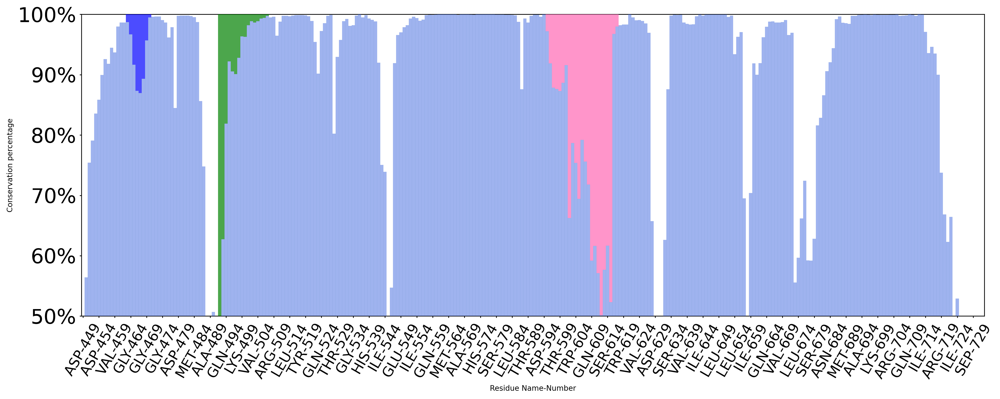

In [13]:
#Finding highly conserved residues (=100% conservation) in the filtered alignments

filtered_aligned = new_aligned2
total_alignments = len(filtered_aligned)

# Get the number of non-gap residues in the sequence
seq1mag = len(filtered_aligned[0].seq1.replace("-", ""))  
counts = np.zeros(seq1mag)

# Write alignment index mapping to file
output_file = "alignment_segment_with_index.csv"
with open(output_file, mode='w', newline='') as file:
    writer = csv.writer(file)
    writer.writerow([ "PDB_Name", "Template_Res", "Target_Res", "Template_Index", "Target_Index"])

    for a in filtered_aligned:
        seq1 = a.seq1  
        seq2 = a.seq2  

        continuous_index = 0  
        num_gap_seq2 = 0      
        segment_with_index = []  

        for idx, (res1, res2) in enumerate(zip(seq1, seq2), start=1):
            if res2 == "-":
                num_gap_seq2 += 1
            if res1 != "-":
                template_index = continuous_index
                target_index = idx - num_gap_seq2

                segment_with_index.append((res1, res2, template_index, target_index))

                if res2 != "-":
                    counts[template_index] += 1

                writer.writerow([a.name, res1, res2, template_index, target_index])
                continuous_index += 1


        print(a.name, segment_with_index)


# Calculate conservation rate at each template position
conservation = counts / total_alignments

# Collect fully conserved residues (100%)
highly_conserved = []
for i, cons_value in enumerate(conservation):
    if cons_value == 1.0:
        highly_conserved.append((i, braf_res()[i], cons_value))

# Save all conservation values sorted by percentage
output_sorted_file = "conservation_sorted.csv"

conservation_data = [
    (i, braf_res()[i], conservation[i]) for i in range(len(conservation))
]

conservation_data_sorted = sorted(conservation_data, key=lambda x: x[2], reverse=True)

with open(output_sorted_file, mode='w', newline='') as file:
    writer = csv.writer(file)
    writer.writerow(["Template_Index", "Residue", "Conservation_Percentage"])
    for idx, res, cons_value in conservation_data_sorted:
        writer.writerow([idx, res, f"{cons_value*100:.2f}%"])

print(f"\nConservation percentages sorted (saved to {output_sorted_file})")

print(f"\nHighly conserved residues (>97%) across {total_alignments} structures:")
for idx, res_name, cons_value in highly_conserved:
    print(f"Position {idx}: {res_name} - {cons_value:.1%} conservation")

print("\nConservation percentages for positions 14-21 (pLoop region):")
for i in range(14, 22):
    if i < len(conservation):
        print(f"Position {i}: {braf_res()[i]} - {conservation[i]*100:.2f}%")

print("\nConservation percentages for positions 43-58 (alphaC region):")
for i in range(43, 59):
    if i < len(conservation):
        print(f"Position {i}: {braf_res()[i]} - {conservation[i]*100:.2f}%")

fig, ax = plt.subplots(1, figsize=(15,6))
x = [*range(len(conservation))]
ax.set_xticks(x[::5])
x_lbl = braf_res()
ax.set_xticklabels(x_lbl[::5], rotation=90, fontsize=7)

# Main bar plot of conservation percentages
bars = ax.bar(x, conservation, linewidth=0.05, width=1, color='royalblue', 
              alpha=0.5, edgecolor='steelblue', zorder=10)

paren_x_start = 14
paren_x_end = 21
paren_y = 1.01  
paren_height = 0.08  
paren_width = paren_x_end - paren_x_start

from matplotlib.patches import Arc

arc_left = Arc(
    xy=(paren_x_start, paren_y + paren_height/2),
    width=0.5, height=paren_height,
    angle=0, theta1=90, theta2=270,
    color='black', lw=2, zorder=20
)
ax.add_patch(arc_left)

arc_right = Arc(
    xy=(paren_x_end, paren_y + paren_height/2),
    width=0.5, height=paren_height,
    angle=0, theta1=-90, theta2=90,
    color='black', lw=2, zorder=20
)
ax.add_patch(arc_right)

paren2_x_start = 43
paren2_x_end = 58

arc2_left = Arc(
    xy=(paren2_x_start, paren_y + paren_height/2),
    width=0.5, height=paren_height,
    angle=0, theta1=90, theta2=270,
    color='black', lw=2, zorder=20
)
ax.add_patch(arc2_left)

arc2_right = Arc(
    xy=(paren2_x_end, paren_y + paren_height/2),
    width=0.5, height=paren_height,
    angle=0, theta1=-90, theta2=90,
    color='black', lw=2, zorder=20
)
ax.add_patch(arc2_right)

arc3_left = Arc(
    xy=(145, paren_y + paren_height/2),
    width=0.5, height=paren_height,
    angle=0, theta1=90, theta2=270,
    color='black', lw=2, zorder=20
)
ax.add_patch(arc3_left)

arc3_right = Arc(
    xy=(168, paren_y + paren_height/2),
    width=0.5, height=paren_height,
    angle=0, theta1=-90, theta2=90,
    color='black', lw=2, zorder=20
)
ax.add_patch(arc3_right)

# Shade background of functional regions with semi-transparent color
color_regions = [
    (paren2_x_start, paren2_x_end, 'green'),
    (paren_x_start, paren_x_end, 'blue'),
    (145, 168, 'hotpink')

]

for start, end, color in color_regions:
    for i in range(start, end+1):
        if i < len(conservation):
            bar_height = conservation[i]
            rect_height = 1.0 - bar_height  
            if rect_height > 0:  
                rect = patches.Rectangle((i-0.5, bar_height), 1, rect_height, 
                                      facecolor=color, alpha=0.7, zorder=5)
                ax.add_patch(rect)

ax.set_xlim(-0.5, len(conservation)-0.5)
ax.set_ylim(0.5, 1.0001)  
ax.tick_params(axis=u'x', which=u'both',length=0,labelsize=15, labelrotation=60)
ax.tick_params(axis=u'y', which=u'both',length=0,labelsize=22)

ax.yaxis.set_major_formatter(FuncFormatter(lambda y, _: '{:.0%}'.format(y)))
plt.xlabel("Residue Name-Number")
plt.ylabel("Conservation percentage")
ax.tick_params(length=2, color="black", direction="out")

plt.tight_layout()
plt.show()

Calculate Ditribution of RMSD value in MUSTANG

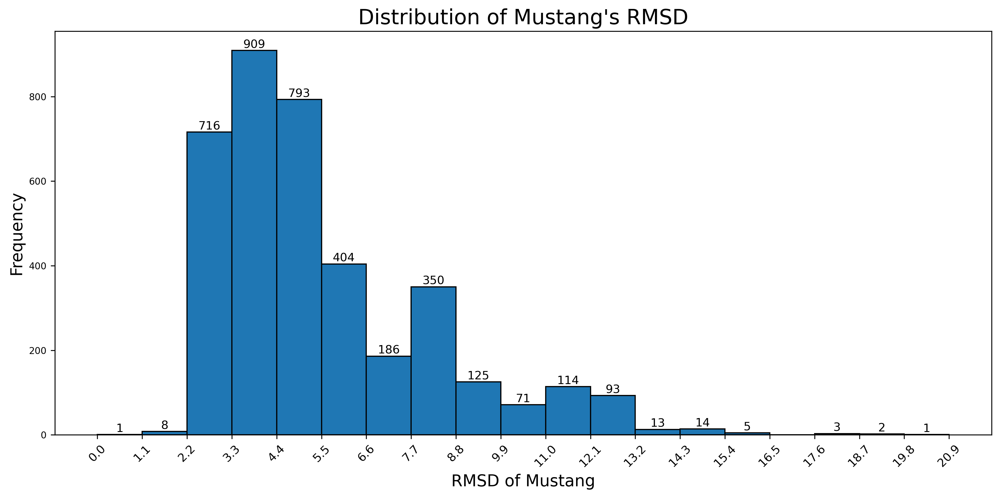

(0.0, 1.1]: 0 structures
(1.1, 2.2]: 11 structures
  - 4FG7_A
  - 4MNE_B
  - 5VAM_A
  - 6Q0J_A
  - 6Q0K_A
  - 6Q0K_B
  - 6Q0T_A
  - 6Q0T_B
  - 6XFP_A
  - 6XLO_A
  - 7K0V_B
(2.2, 3.3]: 713 structures
  - 1FGK_A
  - 1GJO_A
  - 1IG1_A
  - 1JKK_A
  - 1JKL_A
  - 1JKS_A
  - 1JKT_A
  - 1JKT_B
  - 1JOW_B
  - 1M52_A
  - 1M52_B
  - 1OEC_A
  - 1OPJ_B
  - 1OPK_A
  - 1OPL_A
  - 1OPL_B
  - 1P4F_A
  - 1PHK_A
  - 1QL6_A
  - 1QPC_A
  - 1QPD_A
  - 1QPE_A
  - 1QPJ_A
  - 1U46_B
  - 1U4D_B
  - 1U54_A
  - 1U54_B
  - 1U5Q_B
  - 1W98_A
  - 1WVW_A
  - 1WVX_A
  - 1WVY_A
  - 1XBA_A
  - 1XBB_A
  - 1XBC_A
  - 1Y57_A
  - 1YI6_A
  - 1YI6_B
  - 1YRP_A
  - 1YRP_B
  - 1YVJ_A
  - 1ZWS_A
  - 1ZWS_B
  - 1ZWS_C
  - 1ZWS_D
  - 1ZWS_E
  - 1ZWS_F
  - 1ZWS_G
  - 1ZWS_H
  - 2B7A_B
  - 2DQ7_X
  - 2F2C_B
  - 2F4J_A
  - 2FO0_A
  - 2G2F_A
  - 2G2F_B
  - 2G2H_A
  - 2G2H_B
  - 2GQG_A
  - 2GQG_B
  - 2HK5_A
  - 2HYY_C
  - 2HZ0_A
  - 2HZ4_A
  - 2HZ4_B
  - 2HZ4_C
  - 2HZI_A
  - 2HZI_B
  - 2J0L_A
  - 2OF2_A
  - 2OF4_A
  - 2OFU_A
  - 2PHK_

In [14]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

input_file = "Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD/mustang_rmsd_summary.txt"
df = pd.read_csv(input_file, sep=r"\s+", engine="python")  

# Sort all structures by RMSD (descending) and save the result
df_sorted = df.sort_values(by="RMSD", ascending=False)
df_sorted.to_csv("sorted_rmsd_mustang_summary.txt", sep="\t", index=False)

bin_width = 1.1
bins = np.arange(0, df["RMSD"].max() + bin_width, bin_width)

plt.figure(figsize=(12, 6))
n, bins_plot, patches = plt.hist(df["RMSD"], bins=bins, edgecolor='black')

# Label the top of each bar with the count
for count, x in zip(n, bins_plot[:-1]):
    if count > 0:
        plt.text(x + bin_width / 2, count, str(int(count)), ha='center', va='bottom', fontsize=10)

plt.xlabel("RMSD of Mustang", fontsize=14)
plt.ylabel("Frequency", fontsize=14)
plt.title("Distribution of Mustang's RMSD", fontsize=18)
plt.xticks(bins_plot, rotation=45, fontsize=10)
plt.tight_layout()
plt.savefig("ends_rmsd_mustang.png", dpi=300)  
plt.show()

# Group all PDBs into bins based on their RMSD value
df["RMSD_bin"] = pd.cut(df["RMSD"], bins=bins)
grouped = df.groupby("RMSD_bin")["PDB_Name"].apply(list)

for interval, pdb_list in grouped.items():
    print(f"{interval}: {len(pdb_list)} structures")
    for pdb in pdb_list:
        print(f"  - {pdb}")

output_txt = "rmsd_bins_with_pdb_names.txt"
with open(output_txt, "w") as f:
    for interval, pdb_list in grouped.items():
        f.write(f"{interval}: {len(pdb_list)} structures\n")
        for pdb in pdb_list:
            f.write(f"  - {pdb}\n")
        f.write("\n")  



Remove Outliers based on selected value

In [15]:
import os
import shutil
import re

# Input RMSD-bin file and RMSD cutoff threshold
txt_file = "rmsd_bins_with_pdb_names.txt"
rmsd_cutoff_large = 11.0

# Define source and destination directories for PDBs
source_dir="Results/activation_segments/Mustang_with_singlechain_withoutlier"
dest_large="Results/activation_segments/Mustang_with_singlechain"

pdbs_large = set()

# Read the text file and parse PDB names that fall within acceptable RMSD bins
with open(txt_file, "r") as f:
    current_rmsd_range = None
    for line in f:
        line = line.strip()
        if line.startswith("(") and "structures" in line:
            match = re.match(r"\(([\d.]+),\s*([\d.]+)]", line)
            if match:
                low = float(match.group(1))
                high = float(match.group(2))
                current_rmsd_range = (low, high)
        elif line.startswith("-"):
            pdb_id = line[1:].strip().split(".")[0]
            if current_rmsd_range and current_rmsd_range[1] <= rmsd_cutoff_large:
                pdbs_large.add(pdb_id)

os.makedirs(dest_large, exist_ok=True)

# Copy selected PDB files from source to destination folder
for pdb_id in pdbs_large:
    src = os.path.join(source_dir, f"{pdb_id}.pdb")
    dst = os.path.join(dest_large, f"{pdb_id}.pdb")
    if os.path.exists(src):
        shutil.copy2(src, dst)

count_large = len([f for f in os.listdir(dest_large) if f.endswith(".pdb")])
print(f"✅ Copied {count_large} PDBs to {dest_large}")

all_pdb_files = [f[:-4] for f in os.listdir(source_dir) if f.endswith(".pdb")]
not_in_large = sorted(set(all_pdb_files) - pdbs_large)
print(f"\nPDBs NOT in large set (RMSD > {rmsd_cutoff_large}): {len(not_in_large)} structures")
for name in not_in_large:
    print(f" - {name}")


✅ Copied 3565 PDBs to Results/activation_segments/Mustang_with_singlechain

PDBs NOT in large set (RMSD > 11.0): 243 structures
 - 1A9U_A
 - 1BL6_A
 - 1BL7_A
 - 1BMK_A
 - 1DI9_A
 - 1KOB_B
 - 1O6K_A
 - 1OVE_A
 - 1R39_A
 - 1R3C_A
 - 1W7H_A
 - 1W83_A
 - 1W84_A
 - 1WBN_A
 - 1WBO_A
 - 1WBS_A
 - 1WBT_A
 - 1WBV_A
 - 1WBW_A
 - 1YQJ_A
 - 1ZZL_A
 - 2BAJ_A
 - 2GMX_A
 - 2GTM_A
 - 2H96_B
 - 2I0H_A
 - 2JED_A
 - 2LGC_A
 - 2NO3_A
 - 2ONL_C
 - 2ONL_D
 - 2OZA_A
 - 2WAJ_A
 - 2YIX_A
 - 2ZB0_A
 - 2ZB1_A
 - 3D7Z_A
 - 3D83_A
 - 3DS6_C
 - 3DS6_D
 - 3E88_A
 - 3E88_B
 - 3E92_A
 - 3E93_A
 - 3ERK_A
 - 3FI4_A
 - 3FKN_A
 - 3FKO_A
 - 3FL4_A
 - 3FLN_C
 - 3FLQ_A
 - 3FLS_A
 - 3FLW_A
 - 3FLY_A
 - 3FLZ_A
 - 3FMH_A
 - 3FMJ_A
 - 3FMK_A
 - 3FMM_A
 - 3FMN_A
 - 3FSF_A
 - 3GC7_A
 - 3GC8_A
 - 3GC8_B
 - 3GFE_A
 - 3HAM_A
 - 3HAM_B
 - 3HAV_A
 - 3HAV_B
 - 3HAV_C
 - 3HRB_A
 - 3IPH_A
 - 3ITZ_A
 - 3KQ7_A
 - 3MPT_A
 - 3MW1_A
 - 3NNU_A
 - 3NNV_A
 - 3NNW_A
 - 3NPC_A
 - 3NPC_B
 - 3NYV_A
 - 3PY3_A
 - 3RIN_A
 - 3S3I_A
 - 3U8W_A
 - 3UZR_A
 -

Show remove effect

In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt
import mdtraj as md
from glob import glob
from tqdm import tqdm
import pandas as pd
from scipy import stats
import shutil

def tukey_outlier_detection(data, k=1.5):
    """
    Apply Tukey's method to detect outliers using the Interquartile Range (IQR).
    
    Parameters
    ----------
    data : array-like
        The data to analyze for outliers
    k : float, default=1.5
        The multiplier for the IQR. Common values are 1.5 (moderate) or 3.0 (extreme)
        
    Returns
    -------
    tuple
        (outlier_indices, lower_bound, upper_bound, Q1, Q3, IQR)
    """
    data = np.array(data)
    
    # Calculate quartiles
    Q1 = np.percentile(data, 25)
    Q3 = np.percentile(data, 75)
    IQR = Q3 - Q1
    
    # Calculate bounds
    lower_bound = Q1 - k * IQR
    upper_bound = Q3 + k * IQR
    
    # Find outlier indices
    outlier_indices = np.where((data < lower_bound) | (data > upper_bound))[0]
    
    return outlier_indices, lower_bound, upper_bound, Q1, Q3, IQR


import os
import numpy as np
import matplotlib.pyplot as plt

def create_plots(original_ca, clean_ca, output_dir, k_factor, ca_lower, ca_upper, ca_Q1, ca_Q3):
    """
    Create and save three plots (histogram with Tukey cutoffs, clean histogram, and boxplot).
    Each figure is saved separately into `output_dir`.
    Returns:
        dict: filepaths of the saved figures.
    """
    os.makedirs(output_dir, exist_ok=True)
    saved = {}

    # 1) Original CA distribution with Tukey cutoff lines
    fig, ax = plt.subplots(figsize=(12, 8))

    # Histogram
    ax.hist(original_ca, bins=20, alpha=0.7, color='lightblue', edgecolor='black', label='Original Data')

    # Quartiles and Tukey bounds
    ax.axvline(x=ca_lower, color='red', linestyle='--', linewidth=2, label=f'Lower Bound: {ca_lower:.1f}')
    ax.axvline(x=ca_upper, color='red', linestyle='--', linewidth=2, label=f'Upper Bound: {ca_upper:.1f}')
    ax.axvline(x=ca_Q1, color='orange', linestyle=':', linewidth=2, label=f'Q1: {ca_Q1:.1f}')
    ax.axvline(x=ca_Q3, color='orange', linestyle=':', linewidth=2, label=f'Q3: {ca_Q3:.1f}')

    # Median
    median_ca = np.median(original_ca)
    ax.axvline(x=median_ca, color='green', linestyle='-', linewidth=2, label=f'Median: {median_ca:.1f}')

    # Shade outlier regions
    ax.axvspan(min(original_ca), ca_lower, alpha=0.2, color='red', label='Outlier Region')
    ax.axvspan(ca_upper, max(original_ca), alpha=0.2, color='red')

    ax.set_xlabel('Number of CA atoms')
    ax.set_ylabel('Frequency')
    ax.set_title(f'Original Dataset - CA Counts with Tukey Cutoffs (k={k_factor})\n(n={len(original_ca)})')
    ax.grid(True, alpha=0.3)
    ax.legend()

    f1 = os.path.join(output_dir, f'original_ca_distribution_with_cutoffs_k{k_factor}.png')
    fig.tight_layout()
    fig.savefig(f1, dpi=300, bbox_inches='tight')
    plt.close(fig)
    saved['original_hist'] = f1

    # 2) Clean CA distribution
    fig, ax = plt.subplots(figsize=(10, 6))

    ax.hist(clean_ca, bins=20, alpha=0.7, color='lightgreen', edgecolor='black', label='Clean Data')

    clean_median = np.median(clean_ca)
    ax.axvline(x=clean_median, color='darkgreen', linestyle='--', linewidth=2, label=f'Median: {clean_median:.1f}')

    ax.set_xlabel('Number of CA atoms')
    ax.set_ylabel('Frequency')
    ax.set_title(f'Clean Dataset - CA Counts (n={len(clean_ca)})')
    ax.grid(True, alpha=0.3)
    ax.legend()

    f2 = os.path.join(output_dir, f'clean_ca_distribution_k{k_factor}.png')
    fig.tight_layout()
    fig.savefig(f2, dpi=300, bbox_inches='tight')
    plt.close(fig)
    saved['clean_hist'] = f2

    # 3) Box plot comparison for CA counts
    fig, ax = plt.subplots(figsize=(8, 6))

    box_data_ca = [original_ca, clean_ca]
    bp = ax.boxplot(box_data_ca, labels=['Original', 'Clean'], patch_artist=True)
    bp['boxes'][0].set_facecolor('lightblue')
    bp['boxes'][1].set_facecolor('lightgreen')

    ax.set_ylabel('Number of CA atoms')
    ax.set_title('CA Counts Distribution Comparison')
    ax.grid(True, alpha=0.3)

    # Outlier bounds as horizontal lines
    ax.axhline(y=ca_lower, color='red', linestyle='--', alpha=0.7, label='Tukey Bounds')
    ax.axhline(y=ca_upper, color='red', linestyle='--', alpha=0.7)
    ax.legend()

    f3 = os.path.join(output_dir, f'ca_boxplot_comparison_k{k_factor}.png')
    fig.tight_layout()
    fig.savefig(f3, dpi=300, bbox_inches='tight')
    plt.close(fig)
    saved['boxplot'] = f3

    return saved


def analyze_ca_segments_with_outlier_removal(ca_segments_dir, k_factor=1.5):
    """
    Analyzes PDB files in the specified directory, applies Tukey's method to remove outliers based on CA counts only,
    and generates plots showing the cutoffs and cleaned dataset.
    
    Parameters
    ----------
    ca_segments_dir : str
        Directory containing the stripped PDB files with CA atoms
    k_factor : float, default=1.5
        The multiplier for the IQR in Tukey's method
        
    Returns
    -------
    dict
        Dictionary containing analysis results and file information
    """
    # Find all PDB files in the specified directory
    pdb_files = glob(os.path.join(ca_segments_dir, "*.pdb"))
    print(f"Found {len(pdb_files)} PDB files in {ca_segments_dir}")
    
    # Lists to store results
    file_info = []
    
    # Process each PDB file
    for pdb_file in tqdm(pdb_files, desc="Analyzing CA segments"):
        try:
            # Load the PDB file
            traj = md.load(pdb_file)
            
            # Count the number of CA atoms
            num_ca = traj.n_atoms
            
            file_info.append({
                'filename': os.path.basename(pdb_file),
                'filepath': pdb_file,
                'ca_count': num_ca
            })
                
        except Exception as e:
            print(f"Error processing {pdb_file}: {e}")
    
    # Convert to DataFrame for easier manipulation
    df = pd.DataFrame(file_info)
    
    # Extract data for outlier detection
    ca_counts = df['ca_count'].values
    
    print(f"\n{'='*60}")
    print("ORIGINAL DATASET STATISTICS")
    print(f"{'='*60}")
    print(f"Total structures: {len(df)}")
    print(f"CA counts - Min: {ca_counts.min()}, Max: {ca_counts.max()}, Mean: {ca_counts.mean():.2f}, Median: {np.median(ca_counts):.2f}")
    
    # Apply Tukey's method to CA counts
    ca_outlier_indices, ca_lower, ca_upper, ca_Q1, ca_Q3, ca_IQR = tukey_outlier_detection(ca_counts, k=k_factor)
    
    print(f"\n{'='*60}")
    print("TUKEY'S OUTLIER DETECTION - CA COUNTS")
    print(f"{'='*60}")
    print(f"Q1: {ca_Q1:.2f}, Q3: {ca_Q3:.2f}, IQR: {ca_IQR:.2f}")
    print(f"Lower bound: {ca_lower:.2f}, Upper bound: {ca_upper:.2f}")
    print(f"Outliers found: {len(ca_outlier_indices)} out of {len(ca_counts)} ({len(ca_outlier_indices)/len(ca_counts)*100:.1f}%)")
    
    if len(ca_outlier_indices) > 0:
        print("CA count outliers:")
        for idx in ca_outlier_indices:
            print(f"  - {df.iloc[idx]['filename']}: {df.iloc[idx]['ca_count']} CA atoms")
    
    # Create clean dataset based on CA counts
    clean_df = df.drop(df.index[ca_outlier_indices]).reset_index(drop=True)
    
    print(f"\n{'='*60}")
    print("OUTLIER REMOVAL BASED ON CA COUNTS")
    print(f"{'='*60}")
    print(f"Outliers to remove: {len(ca_outlier_indices)} out of {len(df)} ({len(ca_outlier_indices)/len(df)*100:.1f}%)")
    print(f"Clean dataset size: {len(clean_df)} structures")
    
    # Print outliers being removed
    if len(ca_outlier_indices) > 0:
        print("\nStructures being removed as outliers:")
        outlier_df = df.iloc[ca_outlier_indices]
        for _, row in outlier_df.iterrows():
            print(f"  - {row['filename']}: {row['ca_count']} CA atoms")
    
    # Clean dataset statistics
    clean_ca_counts = clean_df['ca_count'].values
    
    print(f"\n{'='*60}")
    print("CLEAN DATASET STATISTICS")
    print(f"{'='*60}")
    print(f"Total structures: {len(clean_df)}")
    print(f"CA counts - Min: {clean_ca_counts.min()}, Max: {clean_ca_counts.max()}, Mean: {clean_ca_counts.mean():.2f}, Median: {np.median(clean_ca_counts):.2f}")
    
    # Create CA distribution plots
    create_plots(ca_counts, clean_ca_counts, ca_segments_dir, k_factor, ca_lower, ca_upper, ca_Q1, ca_Q3)
    
    # # Create clean directory with non-outlier files
    # clean_dir = "Results/activation_segments/CA_segments/mustang_endsAlignment_cleaned"

    # if os.path.exists(clean_dir):
    #     shutil.rmtree(clean_dir)
    # os.makedirs(clean_dir)
    
    # print(f"\nCopying clean structures to: {clean_dir}")
    # for _, row in tqdm(clean_df.iterrows(), total=len(clean_df), desc="Copying clean files"):
    #     src = row['filepath']
    #     dst = os.path.join(clean_dir, row['filename'])
    #     shutil.copy2(src, dst)
    
    # print(f"Created clean directory with {len(clean_df)} structures")
    
    # # Save results
    # results = {
    #     'original_df': df,
    #     'clean_df': clean_df,
    #     'outlier_indices': ca_outlier_indices,
    #     'ca_outlier_info': {
    #         'indices': ca_outlier_indices,
    #         'bounds': (ca_lower, ca_upper),
    #         'quartiles': (ca_Q1, ca_Q3),
    #         'IQR': ca_IQR
    #     },
    #     'k_factor': k_factor
    # }
    
    # # Save outlier information to CSV
    # if len(ca_outlier_indices) > 0:
    #     outlier_df = df.iloc[ca_outlier_indices].copy()
    #     outlier_df.to_csv(os.path.join(ca_segments_dir, f"outliers_removed_k{k_factor}.csv"), index=False)
    #     print(f"Outlier information saved to: outliers_removed_k{k_factor}.csv")
    
    # # Save clean dataset information
    # clean_df.to_csv(os.path.join(ca_segments_dir, f"clean_dataset_k{k_factor}.csv"), index=False)
    # print(f"Clean dataset information saved to: clean_dataset_k{k_factor}.csv")
    
    # return results

# Main execution
if __name__ == "__main__":
    # Directory with CA segments
    ca_dir = "Results/activation_segments/CA_segments/mustang_endsAlignment"

    # Run analysis with k=1.5 (moderate outlier detection)
    k_factor = 1.5
    
    print(f"{'#'*80}")
    print(f"RUNNING TUKEY'S OUTLIER DETECTION WITH k = {k_factor}")
    print(f"{'#'*80}")
    
    analyze_ca_segments_with_outlier_removal(ca_dir, k_factor=k_factor)
    
    # print(f"\nFinal Results:")
    # print(f"- Original dataset: {len(results['original_df'])} structures")
    # print(f"- Clean dataset: {len(results['clean_df'])} structures")
    # print(f"- Outliers removed: {len(results['outlier_indices'])} structures")
    # print(f"- Outlier percentage: {len(results['outlier_indices'])/len(results['original_df'])*100:.1f}%")
    # print(f"- Clean structures saved to: Results/activation_segments/CA_segments/mustang_endsAlignment_cleaned")

################################################################################
RUNNING TUKEY'S OUTLIER DETECTION WITH k = 1.5
################################################################################
Found 2978 PDB files in Results/activation_segments/CA_segments/mustang_endsAlignment


Analyzing CA segments: 100%|██████████| 2978/2978 [00:06<00:00, 464.27it/s]



ORIGINAL DATASET STATISTICS
Total structures: 2978
CA counts - Min: 8, Max: 63, Mean: 27.35, Median: 27.00

TUKEY'S OUTLIER DETECTION - CA COUNTS
Q1: 26.00, Q3: 29.00, IQR: 3.00
Lower bound: 21.50, Upper bound: 33.50
Outliers found: 110 out of 2978 (3.7%)
CA count outliers:
  - 1AD5_A.pdb: 19 CA atoms
  - 1AD5_B.pdb: 19 CA atoms
  - 2CN5_A.pdb: 38 CA atoms
  - 2HCK_A.pdb: 19 CA atoms
  - 2HCK_B.pdb: 19 CA atoms
  - 2W0J_A.pdb: 11 CA atoms
  - 2W7X_A.pdb: 15 CA atoms
  - 2WTC_A.pdb: 36 CA atoms
  - 2WTD_A.pdb: 36 CA atoms
  - 2WTI_A.pdb: 11 CA atoms
  - 2WTJ_A.pdb: 11 CA atoms
  - 2XBJ_A.pdb: 36 CA atoms
  - 2XK9_A.pdb: 38 CA atoms
  - 2XM9_A.pdb: 15 CA atoms
  - 2YCF_A.pdb: 15 CA atoms
  - 2YCQ_A.pdb: 15 CA atoms
  - 2YCR_A.pdb: 38 CA atoms
  - 2YCS_A.pdb: 36 CA atoms
  - 2YIQ_A.pdb: 15 CA atoms
  - 2YIR_A.pdb: 15 CA atoms
  - 2YIT_A.pdb: 38 CA atoms
  - 3ALO_A.pdb: 11 CA atoms
  - 3BHY_A.pdb: 19 CA atoms
  - 4A9R_A.pdb: 38 CA atoms
  - 4A9T_A.pdb: 38 CA atoms
  - 4A9U_A.pdb: 36 CA at

C:\Users\Oakclimber\AppData\Local\Temp\ipykernel_6308\9510727.py:114: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  bp = ax.boxplot(box_data_ca, labels=['Original', 'Clean'], patch_artist=True)
